# Fetch Data

In [1]:
import ccxt
import pandas as pd
from datetime import datetime

# Initialize the Indodax exchange
exchange = ccxt.indodax()

# Define the trading pair and timeframe
symbol = 'USDT/IDR'  # Example: USDT to Indonesian Rupiah
timeframe = '1h'     # Supported timeframes: '1m', '5m', '15m', '1h', '1d', etc.
limit = 60000      # Number of candles to fetch (max depends on the exchange)

# Fetch OHLCV data
ohlcv = exchange.fetch_ohlcv(symbol, timeframe, limit=limit)

# Convert to DataFrame
columns = ['date', 'open', 'high', 'low', 'close', 'volume']
data = [
    [datetime.utcfromtimestamp(c[0] / 1000).strftime('%Y-%m-%d %H:%M:%S'), *c[1:]]
    for c in ohlcv
]
indodax_df = pd.DataFrame(data, columns=columns)

# Ensure 'date' column is in datetime format
indodax_df['date'] = pd.to_datetime(indodax_df['date'])

# Convert from UTC to Bali time (UTC+8)
indodax_df['date'] = indodax_df['date'] + pd.Timedelta(hours=8)

indodax_df = indodax_df.tail(len(indodax_df) - 100)

# Print the DataFrame
indodax_df

,date,open,high,low,close,volume
100,2018-08-28 19:00:00,14543.0,14543.0,14537.0,14537.0,5159.853746
101,2018-08-28 20:00:00,14540.0,14551.0,14538.0,14550.0,1839.865859
102,2018-08-28 21:00:00,14550.0,14551.0,14550.0,14550.0,6104.525120
103,2018-08-28 22:00:00,14550.0,14551.0,14550.0,14551.0,4093.335581
104,2018-08-28 23:00:00,14550.0,14551.0,14550.0,14550.0,11764.586659
...,...,...,...,...,...,...
55197,2024-12-10 12:00:00,15958.0,16000.0,15930.0,15952.0,742184.500807
55198,2024-12-10 13:00:00,15952.0,15969.0,15950.0,15954.0,725729.173691
55199,2024-12-10 14:00:00,15954.0,15954.0,15940.0,15941.0,644117.374338
55200,2024-12-10 15:00:00,15940.0,15950.0,15940.0,15949.0,671340.729321


# Indodax Data Exploration

In [2]:
indodax_df

,date,open,high,low,close,volume
100,2018-08-28 19:00:00,14543.0,14543.0,14537.0,14537.0,5159.853746
101,2018-08-28 20:00:00,14540.0,14551.0,14538.0,14550.0,1839.865859
102,2018-08-28 21:00:00,14550.0,14551.0,14550.0,14550.0,6104.525120
103,2018-08-28 22:00:00,14550.0,14551.0,14550.0,14551.0,4093.335581
104,2018-08-28 23:00:00,14550.0,14551.0,14550.0,14550.0,11764.586659
...,...,...,...,...,...,...
55197,2024-12-10 12:00:00,15958.0,16000.0,15930.0,15952.0,742184.500807
55198,2024-12-10 13:00:00,15952.0,15969.0,15950.0,15954.0,725729.173691
55199,2024-12-10 14:00:00,15954.0,15954.0,15940.0,15941.0,644117.374338
55200,2024-12-10 15:00:00,15940.0,15950.0,15940.0,15949.0,671340.729321


In [47]:
#Get the latest 1000 data
indodax_tail = indodax_df.tail(1000 + 99)

indodax_tail

,date,open,high,low,close,volume
54103,2024-10-25 22:00:00,15674.0,15689.0,15610.0,15669.0,193593.603356
54104,2024-10-25 23:00:00,15669.0,15682.0,15654.0,15681.0,98256.512750
54105,2024-10-26 00:00:00,15681.0,15681.0,15645.0,15680.0,148992.354003
54106,2024-10-26 01:00:00,15680.0,15685.0,15679.0,15685.0,67018.002625
54107,2024-10-26 02:00:00,15685.0,15704.0,15684.0,15704.0,99248.376578
...,...,...,...,...,...,...
55197,2024-12-10 12:00:00,15958.0,16000.0,15930.0,15952.0,742184.500807
55198,2024-12-10 13:00:00,15952.0,15969.0,15950.0,15954.0,725729.173691
55199,2024-12-10 14:00:00,15954.0,15954.0,15940.0,15941.0,644117.374338
55200,2024-12-10 15:00:00,15940.0,15950.0,15940.0,15949.0,671340.729321


In [57]:
import pandas as pd

# Ensure the copy of the DataFrame is present
# check_1 = indodax_df.copy()
check_1 = indodax_tail.copy()

# Select necessary columns
check_1 = check_1[['date', 'close']]

# Look-ahead window size
window_size = 100

# Helper function to determine if max or min is reached first
def max_or_min_first(arr):
    initial_value = arr[0]  # The first element in the array
    changes = (arr - initial_value) / initial_value * 100  # Percentage changes
    max_idx = changes.argmax()  # Index of the max change
    min_idx = changes.argmin()  # Index of the min change
    return 1 if max_idx < min_idx else 0  # 1 for "max", 0 for "min"

# Calculate max and min change percentages
check_1[f'max_{window_size}h_chg_pct'] = (
    check_1['close']
    .rolling(window=window_size, min_periods=1)
    .apply(lambda x: ((x.max() - x[0]) / x[0]) * 100, raw=True)
    .shift(-window_size + 1)
)

check_1[f'min_{window_size}h_chg_pct'] = (
    check_1['close']
    .rolling(window=window_size, min_periods=1)
    .apply(lambda x: ((x.min() - x[0]) / x[0]) * 100, raw=True)
    .shift(-window_size + 1)
)

# Determine whether max or min is reached first (numeric: 1 for max, 0 for min)
check_1['max_or_min_numeric'] = (
    check_1['close']
    .rolling(window=window_size, min_periods=1)
    .apply(max_or_min_first, raw=True)  # Set raw=True to work with NumPy arrays
    .shift(-window_size + 1)
)

# Map numeric values back to "max" or "min"
check_1['max_or_min_first'] = check_1['max_or_min_numeric'].map({1: "max", 0: "min"})

# Drop rows with NaN values
check_1.dropna(inplace=True)

# Drop the intermediate numeric column
check_1.drop(columns=['max_or_min_numeric'], inplace=True)

check_1[f'{window_size}h_pnl_ratio'] = abs(check_1[f'max_{window_size}h_chg_pct'] / check_1[f'min_{window_size}h_chg_pct'])

check_1

,date,close,max_100h_chg_pct,min_100h_chg_pct,max_or_min_first,100h_pnl_ratio
54103,2024-10-25 22:00:00,15669.0,0.836046,0.000000,min,inf
54104,2024-10-25 23:00:00,15681.0,0.758880,-0.038263,min,19.833333
54105,2024-10-26 00:00:00,15680.0,0.765306,-0.031888,min,24.000000
54106,2024-10-26 01:00:00,15685.0,0.733185,-0.063755,min,11.500000
54107,2024-10-26 02:00:00,15704.0,0.611309,-0.184666,min,3.310345
...,...,...,...,...,...,...
55098,2024-12-06 09:00:00,15950.0,0.708464,-0.927900,min,0.763514
55099,2024-12-06 10:00:00,15957.0,0.664285,-0.971361,min,0.683871
55100,2024-12-06 11:00:00,15917.0,0.917258,-0.722498,min,1.269565
55101,2024-12-06 12:00:00,15918.0,0.910918,-0.728735,min,1.250000


In [58]:
# Define the list of thresholds
thresholds = [0.7, 1, 1.5, 2]  # Example thresholds

total_rows = len(check_1)

# Extend the results dictionary to include the 'max_first_percentage' and 'min_first_percentage'
results = {
    "threshold": [],
    "percentage": [],
    "max_first_percentage": [],
    "min_first_percentage": [],
    "pnl_ratio_ge_1_percentage": [],  # Add a column for PnL ratio percentage >= 1
}

# Iterate through each threshold and calculate the percentages
for threshold in thresholds:
    # Total percentage of rows meeting the threshold condition
    count = (check_1['max_100h_chg_pct'] >= threshold).sum()
    percentage = (count / total_rows) * 100
    
    # Percentage of rows touching max first among those meeting the threshold
    max_first_count = (
        check_1[(check_1['max_100h_chg_pct'] >= threshold) & (check_1['max_or_min_first'] == 'max')].shape[0]
    )
    max_first_percentage = (max_first_count / count) * 100 if count > 0 else 0  # Avoid division by zero
    
    # Percentage of rows touching min first among those meeting the threshold
    min_first_count = (
        check_1[(check_1['max_100h_chg_pct'] >= threshold) & (check_1['max_or_min_first'] == 'min')].shape[0]
    )
    min_first_percentage = (min_first_count / count) * 100 if count > 0 else 0  # Avoid division by zero

    # Percentage of rows where PnL ratio >= 1 among those meeting the threshold
    pnl_ratio_count = (
        check_1[(check_1['max_100h_chg_pct'] >= threshold) & (check_1['100h_pnl_ratio'] >= 1)].shape[0]
    )
    pnl_ratio_percentage = (pnl_ratio_count / count) * 100 if count > 0 else 0  # Avoid division by zero
    
    # Append results to the dictionary
    results["threshold"].append(threshold)
    results["percentage"].append(percentage)
    results["max_first_percentage"].append(max_first_percentage)
    results["min_first_percentage"].append(min_first_percentage)
    results["pnl_ratio_ge_1_percentage"].append(pnl_ratio_percentage)  # Add the new column

# Convert the results to a DataFrame
threshold_df = pd.DataFrame(results)

# Add relative max and min first percentages
threshold_df['relative_max_first_percentage'] = threshold_df['percentage'] * threshold_df['max_first_percentage'] / 100
threshold_df['relative_min_first_percentage'] = threshold_df['percentage'] * threshold_df['min_first_percentage'] / 100

# Display the DataFrame
threshold_df

,threshold,percentage,max_first_percentage,min_first_percentage,pnl_ratio_ge_1_percentage,relative_max_first_percentage,relative_min_first_percentage
0,0.7,46.0,22.391304,77.608696,93.260870,10.3,35.7
1,1.0,24.8,17.741935,82.258065,99.193548,4.4,20.4
2,1.5,11.8,11.864407,88.135593,100.000000,1.4,10.4
3,2.0,2.9,0.000000,100.000000,100.000000,0.0,2.9


In [59]:
import pandas as pd

# Define the list of thresholds
thresholds = [0.7]  # Example thresholds

# Create price bins based on the range of 'close' values with an appropriate step size
price_bins = list(range(int(check_1['close'].min()), int(check_1['close'].max()), 50))  # Adjust the step as needed
price_labels = [f"{price_bins[i]}-{price_bins[i+1]}" for i in range(len(price_bins) - 1)]

# Calculate the total number of rows with 'max_100h_chg_pct' >= 0.7
total_rows_above_threshold = (check_1['max_100h_chg_pct'] >= 0.7).sum()

# Dictionary to store results for each threshold and price bin
results = {
    "threshold": [],
    "price_bin": [],
    "percentage": [],
    "max_first_percentage": [],
    "min_first_percentage": [],
    "relative_max_first_percentage": [],
    "relative_min_first_percentage": [],
}

# Iterate through each threshold and each price bin
for threshold in thresholds:
    for i in range(len(price_bins) - 1):
        lower_bound = price_bins[i]
        upper_bound = price_bins[i + 1]
        bin_label = f"{lower_bound}-{upper_bound}"

        # Filter rows that fall within the current price bin
        bin_df = check_1[(check_1['close'] >= lower_bound) & (check_1['close'] < upper_bound)]

        # Calculate the total count of rows meeting the threshold condition within the bin
        count = (bin_df['max_100h_chg_pct'] >= threshold).sum()
        percentage = (count / total_rows_above_threshold) * 100 if total_rows_above_threshold > 0 else 0  # Percentage relative to rows meeting the threshold

        # Calculate the percentage of rows touching max first within the bin
        max_first_count = (
            bin_df[(bin_df['max_100h_chg_pct'] >= threshold) & (bin_df['max_or_min_first'] == 'max')].shape[0]
        )
        max_first_percentage = (max_first_count / count) * 100 if count > 0 else 0  # Avoid division by zero

        # Calculate the percentage of rows touching min first within the bin
        min_first_count = (
            bin_df[(bin_df['max_100h_chg_pct'] >= threshold) & (bin_df['max_or_min_first'] == 'min')].shape[0]
        )
        min_first_percentage = (min_first_count / count) * 100 if count > 0 else 0  # Avoid division by zero

        # Calculate relative percentages for max and min first
        relative_max_first_percentage = (max_first_percentage / 100) * percentage if percentage > 0 else 0
        relative_min_first_percentage = (min_first_percentage / 100) * percentage if percentage > 0 else 0

        # Append results to the dictionary
        results["threshold"].append(threshold)
        results["price_bin"].append(bin_label)
        results["percentage"].append(percentage)
        results["max_first_percentage"].append(max_first_percentage)
        results["min_first_percentage"].append(min_first_percentage)
        results["relative_max_first_percentage"].append(relative_max_first_percentage)
        results["relative_min_first_percentage"].append(relative_min_first_percentage)

# Convert the results to a DataFrame
threshold_bin_df = pd.DataFrame(results)

# Display the DataFrame
threshold_bin_df

,threshold,price_bin,percentage,max_first_percentage,min_first_percentage,relative_max_first_percentage,relative_min_first_percentage
0,0.7,15594-15644,2.826087,7.692308,92.307692,0.217391,2.608696
1,0.7,15644-15694,8.913043,17.073171,82.926829,1.521739,7.391304
2,0.7,15694-15744,23.913043,16.363636,83.636364,3.913043,20.000000
3,0.7,15744-15794,12.826087,0.000000,100.000000,0.000000,12.826087
4,0.7,15794-15844,12.173913,0.000000,100.000000,0.000000,12.173913
5,0.7,15844-15894,28.478261,27.480916,72.519084,7.826087,20.652174
6,0.7,15894-15944,7.826087,77.777778,22.222222,6.086957,1.739130
7,0.7,15944-15994,2.826087,92.307692,7.692308,2.608696,0.217391
8,0.7,15994-16044,0.217391,100.000000,0.000000,0.217391,0.000000
9,0.7,16044-16094,0.000000,0.000000,0.000000,0.000000,0.000000


# Clean + Features Engineering

In [60]:
indodax_df

,date,open,high,low,close,volume
100,2018-08-28 19:00:00,14543.0,14543.0,14537.0,14537.0,5159.853746
101,2018-08-28 20:00:00,14540.0,14551.0,14538.0,14550.0,1839.865859
102,2018-08-28 21:00:00,14550.0,14551.0,14550.0,14550.0,6104.525120
103,2018-08-28 22:00:00,14550.0,14551.0,14550.0,14551.0,4093.335581
104,2018-08-28 23:00:00,14550.0,14551.0,14550.0,14550.0,11764.586659
...,...,...,...,...,...,...
55197,2024-12-10 12:00:00,15958.0,16000.0,15930.0,15952.0,742184.500807
55198,2024-12-10 13:00:00,15952.0,15969.0,15950.0,15954.0,725729.173691
55199,2024-12-10 14:00:00,15954.0,15954.0,15940.0,15941.0,644117.374338
55200,2024-12-10 15:00:00,15940.0,15950.0,15940.0,15949.0,671340.729321


In [86]:
import pandas as pd

# Ensure the copy of the DataFrame is present
# df_base = indodax_df.copy()
df_base = indodax_df.tail(10000)

# Look-ahead window size
window_size = 100

# Helper function to determine if max or min is reached first
def max_or_min_first(arr):
    initial_value = arr[0]  # The first element in the array
    changes = (arr - initial_value) / initial_value * 100  # Percentage changes
    max_idx = changes.argmax()  # Index of the max change
    min_idx = changes.argmin()  # Index of the min change
    return 1 if max_idx < min_idx else 0  # 1 for "max", 0 for "min"

# Calculate max and min change percentages
df_base[f'max_{window_size}h_chg_pct'] = (
    df_base['close']
    .rolling(window=window_size, min_periods=1)
    .apply(lambda x: ((x.max() - x[0]) / x[0]) * 100, raw=True)
    .shift(-window_size + 1)
)

df_base[f'min_{window_size}h_chg_pct'] = (
    df_base['close']
    .rolling(window=window_size, min_periods=1)
    .apply(lambda x: ((x.min() - x[0]) / x[0]) * 100, raw=True)
    .shift(-window_size + 1)
)

# Determine whether max or min is reached first (numeric: 1 for max, 0 for min)
df_base['max_reached_first_flag'] = (
    df_base['close']
    .rolling(window=window_size, min_periods=1)
    .apply(max_or_min_first, raw=True)  # Set raw=True to work with NumPy arrays
    .shift(-window_size + 1)
)

treshold = 0.7

# Defining target
df_base['target_flag'] = ((df_base['max_100h_chg_pct'] >= treshold) & (df_base['max_reached_first_flag'] == 1)).astype(int)

# Drop the intermediate numeric column
df_base.drop(columns=['min_100h_chg_pct','max_100h_chg_pct','max_reached_first_flag'], inplace=True)

# Drop rows with NaN values
df_base.dropna(inplace=True)

df_base

/tmp/ipykernel_1018778/3617465607.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_base[f'max_{window_size}h_chg_pct'] = (
/tmp/ipykernel_1018778/3617465607.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_base[f'min_{window_size}h_chg_pct'] = (
/tmp/ipykernel_1018778/3617465607.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.or

,date,open,high,low,close,volume,target_flag
45202,2023-10-21 01:00:00,15846.0,15874.0,15846.0,15846.0,68533.183377,0
45203,2023-10-21 02:00:00,15846.0,15847.0,15846.0,15846.0,8335.227459,0
45204,2023-10-21 03:00:00,15846.0,15847.0,15846.0,15846.0,24724.110670,0
45205,2023-10-21 04:00:00,15847.0,15847.0,15846.0,15847.0,8997.683009,0
45206,2023-10-21 05:00:00,15847.0,15847.0,15846.0,15847.0,7497.956165,0
...,...,...,...,...,...,...,...
55197,2024-12-10 12:00:00,15958.0,16000.0,15930.0,15952.0,742184.500807,0
55198,2024-12-10 13:00:00,15952.0,15969.0,15950.0,15954.0,725729.173691,0
55199,2024-12-10 14:00:00,15954.0,15954.0,15940.0,15941.0,644117.374338,0
55200,2024-12-10 15:00:00,15940.0,15950.0,15940.0,15949.0,671340.729321,0


In [ ]:
# # Calculate the percentage of target_flag == 1
# target_flag_count = df_base['target_flag'].sum()
# total_rows = len(df_base)
# percentage = (target_flag_count / total_rows) * 100

# print(f"Percentage of target_flag == 1: {percentage:.2f}%")

Percentage of target_flag == 1: 10.10%


In [87]:
df_features = df_base.copy()

# Ensure 'date' column is in datetime format
df_features['date'] = pd.to_datetime(df_features['date'])

# Set date column as index for rolling functions
df_features.set_index('date', inplace=True)

# Function to calculate percentage change
def pct_change(df, period):
    return df.pct_change(periods=period) * 100

# Price Changes (percentage)
df_features['price_change_1h'] = pct_change(df_features['close'], 1)
df_features['price_change_5h'] = pct_change(df_features['close'], 5)
df_features['price_change_10h'] = pct_change(df_features['close'], 10)
df_features['price_change_50h'] = pct_change(df_features['close'], 50)
df_features['price_change_100h'] = pct_change(df_features['close'], 100)
df_features['price_change_200h'] = pct_change(df_features['close'], 200)
df_features['price_change_500h'] = pct_change(df_features['close'], 500)
df_features['price_change_1000h'] = pct_change(df_features['close'], 1000)

# Moving Averages
df_features['ma_close_5'] = df_features['close'].rolling(window=5).mean()
df_features['ma_close_10'] = df_features['close'].rolling(window=10).mean()
df_features['ma_close_20'] = df_features['close'].rolling(window=10).mean()
df_features['ma_close_50'] = df_features['close'].rolling(window=50).mean()
df_features['ma_close_100'] = df_features['close'].rolling(window=100).mean()
df_features['ma_close_200'] = df_features['close'].rolling(window=200).mean()
df_features['ma_close_500'] = df_features['close'].rolling(window=500).mean()
df_features['ma_close_1000'] = df_features['close'].rolling(window=1000).mean()

# Exponential Moving Averages (EMA)
df_features['ema_close_5'] = df_features['close'].ewm(span=5, adjust=False).mean()
df_features['ema_close_10'] = df_features['close'].ewm(span=10, adjust=False).mean()
df_features['ema_close_50'] = df_features['close'].ewm(span=50, adjust=False).mean()
df_features['ema_close_100'] = df_features['close'].ewm(span=100, adjust=False).mean()
df_features['ema_close_200'] = df_features['close'].ewm(span=200, adjust=False).mean()

# Volatility Measures (Rolling Standard Deviation)
df_features['volatility_5h'] = df_features['close'].rolling(window=5).std()
df_features['volatility_10h'] = df_features['close'].rolling(window=10).std()
df_features['volatility_20h'] = df_features['close'].rolling(window=20).std()
df_features['volatility_50h'] = df_features['close'].rolling(window=50).std()
df_features['volatility_100h'] = df_features['close'].rolling(window=100).std()
df_features['volatility_200h'] = df_features['close'].rolling(window=200).std()
df_features['volatility_500h'] = df_features['close'].rolling(window=500).std()

# Rate of Change (ROC)
df_features['roc_1h'] = pct_change(df_features['close'], 1)
df_features['roc_5h'] = pct_change(df_features['close'], 5)
df_features['roc_10h'] = pct_change(df_features['close'], 10)
df_features['roc_50h'] = pct_change(df_features['close'], 50)
df_features['roc_100h'] = pct_change(df_features['close'], 100)

# Volume Indicators
df_features['volume_5h'] = df_features['volume'].rolling(window=5).sum()
df_features['volume_10h'] = df_features['volume'].rolling(window=10).sum()
df_features['volume_20h'] = df_features['volume'].rolling(window=20).sum()
df_features['volume_50h'] = df_features['volume'].rolling(window=50).sum()
df_features['volume_100h'] = df_features['volume'].rolling(window=100).sum()
df_features['volume_200h'] = df_features['volume'].rolling(window=200).sum()
df_features['volume_500h'] = df_features['volume'].rolling(window=500).sum()
df_features['volume_1000h'] = df_features['volume'].rolling(window=1000).sum()

# Moving Average of Volume
df_features['volume_ma_5h'] = df_features['volume'].rolling(window=5).mean()
df_features['volume_ma_10h'] = df_features['volume'].rolling(window=10).mean()
df_features['volume_ma_50h'] = df_features['volume'].rolling(window=50).mean()
df_features['volume_ma_100h'] = df_features['volume'].rolling(window=100).mean()
df_features['volume_ma_200h'] = df_features['volume'].rolling(window=200).mean()

# Relative Strength Index (RSI)
def rsi(series, window=14):
    delta = series.diff()
    gain = (delta.where(delta > 0, 0)).rolling(window=window).mean()
    loss = (-delta.where(delta < 0, 0)).rolling(window=window).mean()
    rs = gain / loss
    return 100 - (100 / (1 + rs))

df_features['rsi_5h'] = rsi(df_features['close'], window=5)
df_features['rsi_10h'] = rsi(df_features['close'], window=10)
df_features['rsi_20h'] = rsi(df_features['close'], window=20)
df_features['rsi_50h'] = rsi(df_features['close'], window=50)
df_features['rsi_100h'] = rsi(df_features['close'], window=100)

# MACD (Moving Average Convergence Divergence)
def macd(df, short_window=12, long_window=26, signal_window=9):
    short_ema = df['close'].ewm(span=short_window, adjust=False).mean()
    long_ema = df['close'].ewm(span=long_window, adjust=False).mean()
    macd = short_ema - long_ema
    signal = macd.ewm(span=signal_window, adjust=False).mean()
    histogram = macd - signal
    return macd, signal, histogram

df_features['macd_12_26_9'], df_features['macd_signal_12_26_9'], df_features['macd_histogram_12_26_9'] = macd(df_features)

# Cumulative Sum of Price Changes
df_features['cumsum_price_change_10h'] = df_features['price_change_10h'].rolling(window=10).sum()
df_features['cumsum_price_change_50h'] = df_features['price_change_50h'].rolling(window=50).sum()
df_features['cumsum_price_change_100h'] = df_features['price_change_100h'].rolling(window=100).sum()
df_features['cumsum_price_change_200h'] = df_features['price_change_200h'].rolling(window=200).sum()

# Price Range Indicators
df_features['range_5h'] = df_features['high'].rolling(window=5).max() - df_features['low'].rolling(window=5).min()
df_features['range_10h'] = df_features['high'].rolling(window=10).max() - df_features['low'].rolling(window=10).min()
df_features['range_50h'] = df_features['high'].rolling(window=50).max() - df_features['low'].rolling(window=50).min()

# Rolling High and Low Resistance Levels
df_features['rolling_high_resistance_5h'] = df_features['high'].rolling(window=5).max()
df_features['rolling_low_resistance_5h'] = df_features['low'].rolling(window=5).min()

df_features['rolling_high_resistance_10h'] = df_features['high'].rolling(window=10).max()
df_features['rolling_low_resistance_10h'] = df_features['low'].rolling(window=10).min()

df_features['rolling_high_resistance_50h'] = df_features['high'].rolling(window=50).max()
df_features['rolling_low_resistance_50h'] = df_features['low'].rolling(window=50).min()

df_features['rolling_high_resistance_100h'] = df_features['high'].rolling(window=100).max()
df_features['rolling_low_resistance_100h'] = df_features['low'].rolling(window=100).min()

df_features['rolling_high_resistance_200h'] = df_features['high'].rolling(window=200).max()
df_features['rolling_low_resistance_200h'] = df_features['low'].rolling(window=200).min()

df_features['rolling_high_resistance_500h'] = df_features['high'].rolling(window=500).max()
df_features['rolling_low_resistance_500h'] = df_features['low'].rolling(window=500).min()

df_features['rolling_high_resistance_1000h'] = df_features['high'].rolling(window=1000).max()
df_features['rolling_low_resistance_1000h'] = df_features['low'].rolling(window=1000).min()

# Calculate the gap between close price and rolling high and low resistance levels
df_features['close_to_high_resistance_gap_5h'] = df_features['close'] - df_features['rolling_high_resistance_5h']
df_features['close_to_low_resistance_gap_5h'] = df_features['close'] - df_features['rolling_low_resistance_5h']

df_features['close_to_high_resistance_10h'] = df_features['close'] - df_features['rolling_high_resistance_10h']
df_features['close_to_low_resistance_10h'] = df_features['close'] - df_features['rolling_low_resistance_10h']

df_features['close_to_high_resistance_50h'] = df_features['close'] - df_features['rolling_high_resistance_50h']
df_features['close_to_low_resistance_50h'] = df_features['close'] - df_features['rolling_low_resistance_50h']

df_features['close_to_high_resistance_100h'] = df_features['close'] - df_features['rolling_high_resistance_100h']
df_features['close_to_low_resistance_100h'] = df_features['close'] - df_features['rolling_low_resistance_100h']

df_features['close_to_high_resistance_200h'] = df_features['close'] - df_features['rolling_high_resistance_200h']
df_features['close_to_low_resistance_200h'] = df_features['close'] - df_features['rolling_low_resistance_200h']

df_features['close_to_high_resistance_500h'] = df_features['close'] - df_features['rolling_high_resistance_500h']
df_features['close_to_low_resistance_500h'] = df_features['close'] - df_features['rolling_low_resistance_500h']

df_features['close_to_high_resistance_1000h'] = df_features['close'] - df_features['rolling_high_resistance_1000h']
df_features['close_to_low_resistance_1000h'] = df_features['close'] - df_features['rolling_low_resistance_1000h']

# Add a column for bullish and bearish candles
df_features['bullish_candle'] = df_features['close'] > df_features['open']  # True for bullish, False for bearish
df_features['bearish_candle'] = df_features['close'] < df_features['open']  # True for bearish, False for bullish

# Create a new column to count the amount of bullish and bearish candles up until the current row
# For this, we use the rolling sum to count the number of bullish candles within the last 1000 hours
df_features['bullish_candle_count_1000h'] = df_features['bullish_candle'].rolling(window=1000).sum()
df_features['bearish_candle_count_1000h'] = df_features['bearish_candle'].rolling(window=1000).sum()

# Optionally, you can also calculate these counts for smaller windows (e.g., 500h, 200h, etc.)
df_features['bullish_candle_count_500h'] = df_features['bullish_candle'].rolling(window=500).sum()
df_features['bearish_candle_count_500h'] = df_features['bearish_candle'].rolling(window=500).sum()

df_features['bullish_candle_count_200h'] = df_features['bullish_candle'].rolling(window=200).sum()
df_features['bearish_candle_count_200h'] = df_features['bearish_candle'].rolling(window=200).sum()

df_features['bullish_candle_count_100h'] = df_features['bullish_candle'].rolling(window=100).sum()
df_features['bearish_candle_count_100h'] = df_features['bearish_candle'].rolling(window=100).sum()

df_features['bullish_candle_count_50h'] = df_features['bullish_candle'].rolling(window=50).sum()
df_features['bearish_candle_count_50h'] = df_features['bearish_candle'].rolling(window=50).sum()

df_features['bullish_candle_count_10h'] = df_features['bullish_candle'].rolling(window=10).sum()
df_features['bearish_candle_count_10h'] = df_features['bearish_candle'].rolling(window=10).sum()

df_features['bullish_candle_count_5h'] = df_features['bullish_candle'].rolling(window=5).sum()
df_features['bearish_candle_count_5h'] = df_features['bearish_candle'].rolling(window=5).sum()

# Price Change Relative to Moving Averages
df_features['price_vs_ma_5'] = df_features['close'] / df_features['ma_close_5']
df_features['price_vs_ma_10'] = df_features['close'] / df_features['ma_close_10']
df_features['price_vs_ma_50'] = df_features['close'] / df_features['ma_close_50']
df_features['price_vs_ma_100'] = df_features['close'] / df_features['ma_close_100']
df_features['price_vs_ma_200'] = df_features['close'] / df_features['ma_close_200']

# ATR (Average True Range) function with rolling window of 5, 10, 20, 50, 100, 200
def atr(df, window=14):
    high_low = df['high'] - df['low']
    high_close = abs(df['high'] - df['close'].shift())
    low_close = abs(df['low'] - df['close'].shift())
    true_range = pd.concat([high_low, high_close, low_close], axis=1).max(axis=1)
    return true_range.rolling(window=window).mean()

# Apply ATR for various windows
windows = [5, 10, 20, 50, 100, 200]
for window in windows:
    df_features[f'atr_{window}'] = atr(df_features, window=window)

# Bollinger Bands
df_features['bollinger_upper_20'] = df_features['ma_close_20'] + 2 * df_features['volatility_20h']
df_features['bollinger_lower_20'] = df_features['ma_close_20'] - 2 * df_features['volatility_20h']

# Stochastic Oscillator (K and D values) with rolling window sizes
def stochastic_oscillator(df, window=14):
    low_min = df['low'].rolling(window=window).min()
    high_max = df['high'].rolling(window=window).max()
    stoch_k = 100 * (df['close'] - low_min) / (high_max - low_min)
    stoch_d = stoch_k.rolling(window=3).mean()  # %D is 3-period SMA of %K
    return stoch_k, stoch_d

# Apply Stochastic Oscillator for various windows
for window in windows:
    df_features[f'stoch_k_{window}'], df_features[f'stoch_d_{window}'] = stochastic_oscillator(df_features, window=window)

# Momentum (rolling windows: 5, 10, 20, 50, 100, 200)
for window in [5, 10, 20, 50, 100, 200]:
    df_features[f'momentum_{window}h'] = df_features['close'] - df_features['close'].shift(window)

# Relative Volume (rolling windows: 5, 10, 20, 50, 100, 200)
for window in [5, 10, 20, 50, 100, 200]:
    df_features[f'relative_volume_{window}h'] = df_features['volume'] / df_features[f'volume_{window}h']

# VWAP (rolling windows: 5, 10, 20, 50, 100, 200)
for window in [5, 10, 20, 50, 100, 200]:
    df_features[f'vwap_{window}h'] = (df_features['close'] * df_features['volume']).rolling(window=window).sum() / df_features['volume'].rolling(window=window).sum()

# Correlation (rolling windows: 5, 10, 20, 50, 100, 200)
for window in [5, 10, 20, 50, 100, 200]:
    df_features[f'corr_1h_{window}h'] = df_features['close'].rolling(window=window).corr(df_features['close'].shift(1))

# Price Acceleration (rolling windows: 5, 10, 20, 50, 100, 200)
for window in [5, 10, 20, 50, 100, 200]:
    df_features[f'price_acceleration_{window}h'] = df_features['price_change_1h'].diff(window)

# Rolling Features: Apply multiple rolling windows to these features
def apply_rolling_windows(df, feature, windows):
    for window in windows:
        df[f'{feature}_ma_{window}'] = df[feature].rolling(window=window).mean()
        df[f'{feature}_std_{window}'] = df[feature].rolling(window=window).std()
        df[f'{feature}_max_{window}'] = df[feature].rolling(window=window).max()
        df[f'{feature}_min_{window}'] = df[feature].rolling(window=window).min()
        df[f'{feature}_sum_{window}'] = df[feature].rolling(window=window).sum()
        df[f'{feature}_skew_{window}'] = df[feature].rolling(window=window).skew()
        df[f'{feature}_kurt_{window}'] = df[feature].rolling(window=window).kurt()

# Apply rolling features to 'close' and 'volume' columns
apply_rolling_windows(df_features, 'close', windows)
apply_rolling_windows(df_features, 'volume', windows)

# Drop NA values from rolling calculations
df_features.dropna(inplace=True)

# Reset index if needed
df_features.reset_index(inplace=True)

df_features


/tmp/ipykernel_1018778/589476273.py:170: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_features['bearish_candle_count_100h'] = df_features['bearish_candle'].rolling(window=100).sum()
/tmp/ipykernel_1018778/589476273.py:172: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_features['bullish_candle_count_50h'] = df_features['bullish_candle'].rolling(window=50).sum()
/tmp/ipykernel_1018778/589476273.py:173: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which

,date,open,high,low,close,volume,target_flag,price_change_1h,price_change_5h,price_change_10h,...,volume_sum_100,volume_skew_100,volume_kurt_100,volume_ma_200,volume_std_200,volume_max_200,volume_min_200,volume_sum_200,volume_skew_200,volume_kurt_200
0,2023-12-01 17:00:00,15503.0,15503.0,15502.0,15502.0,198586.873230,0,0.000000,-0.141716,-0.154579,...,1.362929e+07,2.613027,11.689630,114984.597697,107226.822645,8.043066e+05,4252.045625,2.299692e+07,3.221352,16.269523
1,2023-12-01 18:00:00,15503.0,15503.0,15502.0,15502.0,145100.766995,0,0.000000,-0.141716,-0.161010,...,1.367292e+07,2.605125,11.674452,115322.662085,107214.593210,8.043066e+05,4252.045625,2.306453e+07,3.213229,16.236881
2,2023-12-01 19:00:00,15503.0,15503.0,15502.0,15502.0,203587.524749,0,0.000000,-0.148148,0.012903,...,1.307220e+07,1.212932,2.203385,115838.627787,107390.552415,8.043066e+05,4252.045625,2.316773e+07,3.185733,16.050564
3,2023-12-01 20:00:00,15502.0,15503.0,15502.0,15503.0,115362.364409,0,0.006451,-0.135274,-0.064462,...,1.290784e+07,1.272622,2.511288,116083.087165,107333.240540,8.043066e+05,4252.045625,2.321662e+07,3.184431,16.061519
4,2023-12-01 21:00:00,15502.0,15509.0,15502.0,15509.0,130891.139871,0,0.038702,0.045155,-0.096625,...,1.282639e+07,1.308628,2.649114,115879.635380,107266.057398,8.043066e+05,4252.045625,2.317593e+07,3.195476,16.133778
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8835,2024-12-10 12:00:00,15958.0,16000.0,15930.0,15952.0,742184.500807,0,-0.031334,-0.641545,0.415460,...,3.641253e+07,0.869910,-0.041719,487753.050883,563130.184274,4.983441e+06,26410.088226,9.755061e+07,4.456694,26.925192
8836,2024-12-10 13:00:00,15952.0,15969.0,15950.0,15954.0,725729.173691,0,0.012538,-0.181443,0.434372,...,3.648298e+07,0.866400,-0.069905,490276.375867,563059.845483,4.983441e+06,26410.088226,9.805528e+07,4.445706,26.858641
8837,2024-12-10 14:00:00,15954.0,15954.0,15940.0,15941.0,644117.374338,0,-0.081484,-0.050160,0.257862,...,3.664546e+07,0.846485,-0.138152,492226.668330,562913.049462,4.983441e+06,26410.088226,9.844533e+07,4.439165,26.826871
8838,2024-12-10 15:00:00,15940.0,15950.0,15940.0,15949.0,671340.729321,0,0.050185,0.012542,-0.306288,...,3.659193e+07,0.848797,-0.118079,493396.994581,563041.531312,4.983441e+06,26410.088226,9.867940e+07,4.429996,26.762059


In [88]:
# List of columns to always keep
essential_columns = ['date', 'open', 'high', 'low', 'close', 'volume', 'target_flag']

# Calculate the correlation of each feature with the target
correlation_with_target = df_features.corr()['target_flag'].abs()

# Filter features based on correlation threshold (>= 0.1025)
filtered_features = correlation_with_target[correlation_with_target >= 0.1025].index.tolist()

# Combine essential columns with the filtered features (ensure 'date' and OHLCV are always kept)
final_features = list(set(essential_columns + filtered_features))

# Keep only the filtered features in the DataFrame
df_filtered = df_features[final_features]

df_filtered

,open,volume_20h,volatility_10h,volume_ma_10h,volume,volatility_20h,close_std_10,volatility_100h,volume_10h,target_flag,...,low,volatility_5h,close_std_100,close_to_high_resistance_10h,volume_sum_20,volume_ma_10,high,volume_min_50,date,volume_min_20
0,15503.0,2.269346e+06,11.118053,154382.064232,198586.873230,13.628144,11.118053,50.216264,1.543821e+06,0,...,15502.0,12.239281,50.216264,-25.0,2.269346e+06,154382.064232,15503.0,10858.049872,2023-12-01 17:00:00,22283.718572
1,15503.0,2.201466e+06,11.303883,163288.134380,145100.766995,14.207022,11.303883,49.425181,1.632881e+06,0,...,15502.0,12.328828,49.425181,-25.0,2.201466e+06,163288.134380,15503.0,10858.049872,2023-12-01 18:00:00,22283.718572
2,15503.0,2.251656e+06,11.043349,170855.219437,203587.524749,14.489561,11.043349,49.169641,1.708552e+06,0,...,15502.0,9.838699,49.169641,-23.0,2.251656e+06,170855.219437,15503.0,10858.049872,2023-12-01 19:00:00,22283.718572
3,15502.0,2.293987e+06,11.602682,154542.033643,115362.364409,14.499637,11.602682,48.909080,1.545420e+06,0,...,15502.0,0.447214,48.909080,-22.0,2.293987e+06,154542.033643,15503.0,10858.049872,2023-12-01 20:00:00,22283.718572
4,15502.0,2.349961e+06,11.005554,150076.348093,130891.139871,13.888560,11.005554,48.642173,1.500763e+06,0,...,15502.0,3.049590,48.642173,-16.0,2.349961e+06,150076.348093,15509.0,10858.049872,2023-12-01 21:00:00,22283.718572
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8835,15958.0,1.036274e+07,58.121425,557929.595280,742184.500807,52.472148,58.121425,49.871021,5.579296e+06,0,...,15930.0,14.690133,49.871021,-182.0,1.036274e+07,557929.595280,16000.0,41282.186995,2024-12-10 12:00:00,89001.589403
8836,15952.0,1.048157e+07,50.672807,621602.353709,725729.173691,52.328190,50.672807,49.923597,6.216024e+06,0,...,15950.0,3.962323,49.923597,-180.0,1.048157e+07,621602.353709,15969.0,41282.186995,2024-12-10 13:00:00,89001.589403
8837,15954.0,1.021563e+07,45.224010,642340.531240,644117.374338,51.188480,45.224010,49.722514,6.423405e+06,0,...,15940.0,6.300794,49.722514,-193.0,1.021563e+07,642340.531240,15954.0,41282.186995,2024-12-10 14:00:00,89001.589403
8838,15940.0,1.018564e+07,45.697070,668860.530039,671340.729321,50.762891,45.697070,50.020072,6.688605e+06,0,...,15940.0,6.107373,50.020072,-185.0,1.018564e+07,668860.530039,15950.0,41282.186995,2024-12-10 15:00:00,89001.589403


# Logistic Regression

In [ ]:
import time
import numpy as np
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_auc_score, f1_score, accuracy_score

# Separate df into features and target
features_df = df_filtered.drop(['date', 'target_flag'], axis=1)
target_df = df_filtered['target_flag']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# Specify parameters for the sliding window approach
num_predictions = 1  # Number of rows to predict
gap = 1              # Gap (number of rows to skip after each window)
max_windows = 50     # Maximum number of windows to process
set_limit = False    # Set this to False to process all windows

# List of window sizes
# window_sizes = list(range(1200, 1401, 10))
window_sizes = [5000]

# List to store results
results = []

# Loop through each window size
for window_size in window_sizes:
    # Initiate lists to store training metrics
    train_accuracies = []
    train_f1_scores = []
    train_roc_auc_scores = []
    
    # List to store validation metrics
    validation_preds = []
    validation_true = []

    # Total time tracking
    total_window_times = 0

    # Calculate the number of windows based on dataset size
    num_windows = len(X) - window_size - num_predictions

    # Apply maximum window limit if set
    if set_limit:
        num_windows = min(num_windows, max_windows)

    # Loop through each sliding window with the gap applied
    window_number = 0
    while window_number < num_windows:
        if window_number % 500 == 0:
            print(f'Processing window {window_number} of {num_windows}')

        start = window_number
        end = start + window_size
        X_train = X[start:end]
        y_train = y[start:end]

        # Normalize training data
        X_train_mean = np.mean(X_train, axis=0)
        X_train_std = np.std(X_train, axis=0)
        X_train_normalized = (X_train - X_train_mean) / X_train_std

        # Prepare validation data
        X_val = X[end:end + num_predictions]
        y_val = y[end:end + num_predictions]

        # Normalize validation data using training statistics
        X_val_normalized = (X_val - X_train_mean) / X_train_std

        # Track the start time
        start_time = time.time()

        # Initialize and fit the Logistic Regression model
        model = LogisticRegression(max_iter=1000)
        model.fit(X_train_normalized, y_train)

        # Training metrics
        y_train_pred = model.predict(X_train_normalized)
        train_accuracy = accuracy_score(y_train, y_train_pred)
        train_f1 = f1_score(y_train, y_train_pred)
        train_roc_auc = roc_auc_score(y_train, model.predict_proba(X_train_normalized)[:, 1])

        train_accuracies.append(train_accuracy)
        train_f1_scores.append(train_f1)
        train_roc_auc_scores.append(train_roc_auc)

        # Predict on validation data
        y_pred_val = model.predict(X_val_normalized)
        
        # Record predictions and true values for validation
        validation_preds.extend(y_pred_val)
        validation_true.extend(y_val)

        # Track the end time
        end_time = time.time()
        window_time = end_time - start_time
        total_window_times += window_time  # Add the window time to total time

        # Move to the next window based on the gap
        window_number += gap

    # Calculate average training metrics
    avg_train_accuracy = np.mean(train_accuracies)
    avg_train_f1 = np.mean(train_f1_scores)
    avg_train_roc_auc = np.mean(train_roc_auc_scores)

    # Calculate validation metrics
    validation_accuracy = accuracy_score(validation_true, validation_preds)
    validation_f1 = f1_score(validation_true, validation_preds)
    validation_roc_auc = roc_auc_score(validation_true, validation_preds)

    # Store the results
    results.append({
        'window_size': window_size,
        'avg_train_accuracy': avg_train_accuracy,
        'avg_train_f1': avg_train_f1,
        'avg_train_roc_auc': avg_train_roc_auc,
        'validation_accuracy': validation_accuracy,
        'validation_f1': validation_f1,
        'validation_roc_auc': validation_roc_auc,
    })

    # Print results for the current window size
    print(f'Window size [{window_size}] | Time Elapsed: {total_window_times:.3f} seconds')
    print(f'Average Train Accuracy: {avg_train_accuracy:.3f} | Average Train F1: {avg_train_f1:.3f} | Average Train ROC-AUC: {avg_train_roc_auc:.3f}')
    print(f'Validation Accuracy: {validation_accuracy:.3f} | Validation F1: {validation_f1:.3f} | Validation ROC-AUC: {validation_roc_auc:.3f}')
    print(f'===================================================================================')

# Convert results to DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

Processing window 0 of 3839
Processing window 500 of 3839
Processing window 1000 of 3839
Processing window 1500 of 3839


In [50]:
import time
import numpy as np
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_auc_score

# Separate df into features and target
features_df = df.drop(['date', 'next_close_change'], axis=1)
target_df = df['next_close_change']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# Specify parameters for the sliding window approach
num_predictions = 1   # Number of rows to predict
gap = 1               # Gap (number of rows to skip after each window)
max_windows = 50      # Maximum number of windows to process
set_limit = False     # Set this to False to process all windows

# Define list of window sizes
# window_sizes = list(range(100, 1001, 100))
window_sizes = [600]

# List to store results
results = []

# Lists to store all predictions and actuals for ROC-AUC calculation
all_predictions = []
all_actuals = []

# Loop through each window size
for window_size in window_sizes:

    # Initiate lists to store F1 scores and accuracies
    all_f1_scores = []
    accuracies = []
    total_window_times = 0  # Variable to store total time for all windows

    # Calculate the number of windows based on dataset size
    num_windows = len(X) - window_size - num_predictions

    # Apply maximum window limit if set
    if set_limit:
        num_windows = min(num_windows, max_windows)

    # Loop through each sliding window with the gap applied
    window_number = 0
    while window_number < num_windows:

        if window_number % 1000 == 0:
            print(f'Processing window {window_number} of {num_windows}')

        start = window_number
        end = start + window_size
        X_train = X[start:end]
        y_train = y[start:end]

        X_train_mean = np.mean(X_train, axis=0)
        X_train_std = np.std(X_train, axis=0)
        X_train_normalized = (X_train - X_train_mean) / X_train_std

        # Prepare validation data for prediction
        X_val = X[end:end + num_predictions]
        y_val = y[end:end + num_predictions]

        # Normalize validation data using the statistics from the training set
        X_val_normalized = (X_val - X_train_mean) / X_train_std

        # Track the start time of the window processing
        start_time = time.time()

        # Initialize and fit the Logistic Regression model
        model = LogisticRegression(max_iter=1000)  # Increased max_iter for convergence if needed
        model.fit(X_train_normalized, y_train)  # Train without normalizing y_train

        # Predict on validation data
        y_pred_val = model.predict(X_val_normalized)

        # Store prediction and actual data for ROC-AUC calculation
        all_predictions.append(y_pred_val[0])
        all_actuals.append(y_val[0])

        # Binary prediction and ground truth
        y_pred_binary_val = np.where(y_pred_val == True, 1, 0)  # Binary prediction (1 if predicted value <= 0.03)
        y_binary_val = np.where(y_val == True, 1, 0)  # Binary ground truth (1 if actual value is True, else 0)

        # Calculate True Positives (TP), False Positives (FP), False Negatives (FN), and True Negatives (TN)
        TP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 1))
        FP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 0))
        FN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 1))
        TN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 0))

        # Calculate Precision and Recall safely
        precision = TP / (TP + FP) if (TP + FP) > 0 else 0  # Avoid division by zero
        recall = TP / (TP + FN) if (TP + FN) > 0 else 0  # Avoid division by zero

        # Calculate F1 Score safely
        f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

        # Calculate Accuracy
        accuracy = (TP + TN) / (TP + TN + FP + FN) if (TP + TN + FP + FN) > 0 else 0

        # Store the results
        all_f1_scores.append(f1)
        accuracies.append(accuracy)

        # Track the end time of the window processing
        end_time = time.time()

        # Calculate the time taken for this window
        window_time = end_time - start_time
        total_window_times += window_time  # Add the window time to the total time

        # Move to the next window based on the gap
        window_number += gap

    # Calculate average F1 score and accuracy
    avg_f1_score = np.mean(all_f1_scores)
    avg_accuracy = np.mean(accuracies)

    # Calculate ROC-AUC score
    if len(set(all_actuals)) > 1:  # Ensure there are both classes present
        roc_auc = roc_auc_score(all_actuals, all_predictions)
    else:
        roc_auc = np.nan  # Cannot calculate ROC-AUC with only one class

    # Store the results
    results.append({
        'window_size': window_size,
        'avg_f1_score': avg_f1_score,
        'avg_accuracy': avg_accuracy,
        'roc_auc': roc_auc,
        'total_time': total_window_times
    })

    # Print results for the current window size with the new name
    print(f'Window size [{window_size}] | Time Elapsed: {total_window_times:.3f} seconds')
    print(f'Average F1 Score: {avg_f1_score:.3f} | Average Accuracy: {avg_accuracy:.3f} | ROC-AUC: {roc_auc:.3f}')
    print(f'===================================================================================')

# Convert the results into a DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

Processing window 0 of 3178


Processing window 1000 of 3178
Processing window 2000 of 3178
Processing window 3000 of 3178
Window size [600] | Time Elapsed: 16.955 seconds
Average F1 Score: 0.484 | Average Accuracy: 0.571 | ROC-AUC: 0.529


,window_size,avg_f1_score,avg_accuracy,roc_auc,total_time
0,600,0.483952,0.571114,0.529225,16.954979


# Logistic (random split)

In [64]:
import time
import numpy as np
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

# Set the seed for reproducibility
np.random.seed(42)

# Separate df into features and target
features_df = df.drop(['date', 'next_close_change'], axis=1)
target_df = df['next_close_change']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# List of training-validation split proportions (percentage of data used for training)
# split_proportions = [0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95]  # Example proportions: 60%, 70%, 80% training data
split_proportions = [0.85]

# List to store results
results = []

# Loop through each split proportion
for train_size in split_proportions:
    # Split the dataset into training and validation sets
    X_train, X_val, y_train, y_val = train_test_split(
        X, y, train_size=train_size, random_state=42, shuffle=True
    )

    # Normalize the training data
    X_train_mean = np.mean(X_train, axis=0)
    X_train_std = np.std(X_train, axis=0)
    X_train_normalized = (X_train - X_train_mean) / X_train_std

    # Normalize validation data using the statistics from the training set
    X_val_normalized = (X_val - X_train_mean) / X_train_std

    # Track the start time of the processing
    start_time = time.time()

    # Initialize and fit the Logistic Regression model
    model = LogisticRegression(max_iter=1000, random_state=42)  # Increased max_iter for convergence
    model.fit(X_train_normalized, y_train)  # Train without normalizing y_train

    # Predict on training data
    y_pred_train = model.predict(X_train_normalized)
    y_pred_binary_train = np.where(y_pred_train == True, 1, 0)  # Binary prediction
    y_binary_train = np.where(y_train == True, 1, 0)  # Binary ground truth

    # Predict on validation data
    y_pred_val = model.predict(X_val_normalized)
    y_pred_binary_val = np.where(y_pred_val == True, 1, 0)  # Binary prediction
    y_binary_val = np.where(y_val == True, 1, 0)  # Binary ground truth

    # Function to calculate metrics
    def calculate_metrics(y_true, y_pred):
        TP = np.sum((y_pred == 1) & (y_true == 1))
        FP = np.sum((y_pred == 1) & (y_true == 0))
        FN = np.sum((y_pred == 0) & (y_true == 1))
        TN = np.sum((y_pred == 0) & (y_true == 0))
        accuracy = (TP + TN) / (TP + TN + FP + FN) if (TP + TN + FP + FN) > 0 else 0
        precision = TP / (TP + FP) if (TP + FP) > 0 else 0
        recall = TP / (TP + FN) if (TP + FN) > 0 else 0
        f1_score = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0
        return accuracy, f1_score

    # Calculate metrics for training and validation datasets
    train_accuracy, train_f1_score = calculate_metrics(y_binary_train, y_pred_binary_train)
    val_accuracy, val_f1_score = calculate_metrics(y_binary_val, y_pred_binary_val)

    # Track the end time of the processing
    end_time = time.time()

    # Calculate the time taken for this split
    total_time = end_time - start_time

    # Store the results
    results.append({
        'train_size': train_size,
        'train_accuracy': train_accuracy,
        'train_f1_score': train_f1_score,
        'val_accuracy': val_accuracy,
        'val_f1_score': val_f1_score,
        'total_time': total_time
    })

    # Print results for the current split proportion
    print(f'Train Size [{train_size}] | Time Elapsed: {total_time:.3f} seconds')
    print(f'Training - Accuracy: {train_accuracy:.3f} | F1 Score: {train_f1_score:.3f}')
    print(f'Validation - Accuracy: {val_accuracy:.3f} | F1 Score: {val_f1_score:.3f}')
    print(f'===================================================================================')

# Convert the results into a DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

Train Size [0.85] | Time Elapsed: 0.068 seconds
Training - Accuracy: 0.648 | F1 Score: 0.786
Validation - Accuracy: 0.671 | F1 Score: 0.802


,train_size,train_accuracy,train_f1_score,val_accuracy,val_f1_score,total_time
0,0.85,0.647787,0.785774,0.670564,0.802492,0.06819


# Logistic (split)

In [102]:
import time
import numpy as np
import pandas as pd
from sklearn.linear_model import LogisticRegression

# Set the seed for reproducibility
np.random.seed(42)

# Separate df into features and target
features_df = df.drop(['date', 'next_close_change'], axis=1)
target_df = df['next_close_change']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# List of training-validation split proportions (percentage of data used for training)
# split_proportions = [0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95]
# split_proportions = list(range(0.05, 0.96, 0.5))
# split_proportions = np.arange(0.05, 0.96, 0.05)
split_proportions = [0.65]  # 85% training, 15% validation (change as needed)

# List to store results
results = []

# Loop through each split proportion
for train_size in split_proportions:
    # Calculate the index to split the data
    split_index = int(train_size * len(X))
    
    # Split the dataset into training and validation sets (using the first 70% for training)
    X_train = X[:split_index]
    y_train = y[:split_index]
    X_val = X[split_index:]
    y_val = y[split_index:]

    # Normalize the training data
    X_train_mean = np.mean(X_train, axis=0)
    X_train_std = np.std(X_train, axis=0)
    X_train_normalized = (X_train - X_train_mean) / X_train_std

    # Normalize validation data using the statistics from the training set
    X_val_normalized = (X_val - X_train_mean) / X_train_std

    # Track the start time of the processing
    start_time = time.time()

    # Initialize and fit the Logistic Regression model
    model = LogisticRegression(max_iter=1000, random_state=42)  # Increased max_iter for convergence
    model.fit(X_train_normalized, y_train)  # Train without normalizing y_train

    # Predict on training data
    y_pred_train = model.predict(X_train_normalized)
    y_pred_binary_train = np.where(y_pred_train == True, 1, 0)  # Binary prediction
    y_binary_train = np.where(y_train == True, 1, 0)  # Binary ground truth

    # Predict on validation data
    y_pred_val = model.predict(X_val_normalized)
    y_pred_binary_val = np.where(y_pred_val == True, 1, 0)  # Binary prediction
    y_binary_val = np.where(y_val == True, 1, 0)  # Binary ground truth

    # Function to calculate metrics
    def calculate_metrics(y_true, y_pred):
        TP = np.sum((y_pred == 1) & (y_true == 1))
        FP = np.sum((y_pred == 1) & (y_true == 0))
        FN = np.sum((y_pred == 0) & (y_true == 1))
        TN = np.sum((y_pred == 0) & (y_true == 0))
        accuracy = (TP + TN) / (TP + TN + FP + FN) if (TP + TN + FP + FN) > 0 else 0
        precision = TP / (TP + FP) if (TP + FP) > 0 else 0
        recall = TP / (TP + FN) if (TP + FN) > 0 else 0
        f1_score = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0
        return accuracy, f1_score

    # Calculate metrics for training and validation datasets
    train_accuracy, train_f1_score = calculate_metrics(y_binary_train, y_pred_binary_train)
    val_accuracy, val_f1_score = calculate_metrics(y_binary_val, y_pred_binary_val)

    # Track the end time of the processing
    end_time = time.time()

    # Calculate the time taken for this split
    total_time = end_time - start_time

    # Store the results
    results.append({
        'train_size': train_size,
        'train_accuracy': train_accuracy,
        'train_f1_score': train_f1_score,
        'val_accuracy': val_accuracy,
        'val_f1_score': val_f1_score,
        'total_time': total_time
    })

    # Print results for the current split proportion
    print(f'Train Size [{train_size}] | Time Elapsed: {total_time:.3f} seconds')
    print(f'Training - Accuracy: {train_accuracy:.3f} | F1 Score: {train_f1_score:.3f}')
    print(f'Validation - Accuracy: {val_accuracy:.3f} | F1 Score: {val_f1_score:.3f}')
    print(f'===================================================================================')

# Convert the results into a DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

Train Size [0.65] | Time Elapsed: 0.199 seconds
Training - Accuracy: 0.595 | F1 Score: 0.713
Validation - Accuracy: 0.648 | F1 Score: 0.782


,train_size,train_accuracy,train_f1_score,val_accuracy,val_f1_score,total_time
0,0.65,0.594913,0.713255,0.647833,0.78168,0.199224


# Logistic Predictions Evaluations

In [17]:
import pandas as pd
import numpy as np
from sklearn.metrics import accuracy_score, f1_score

# Example data (selecting rows)
X_new = df[df['date'] >= '2024-12-02'].copy()
X_new = X_new.dropna().reset_index(drop=True)

# Create 'next_close' and 'next_close_change'
X_new['next_close'] = X_new['close'].shift(-1)
X_new['next_close_change'] = X_new['next_close'] - X_new['close']

# Create binary labels for 'next_close_change' (1 if positive change, 0 if non-positive)
X_new['next_close_change_binary'] = (X_new['next_close_change'] > 0).astype(int)

# Separate features and target
X_features = X_new.drop(['date', 'next_close_change', 'next_close', 'next_close_change_binary'], axis=1)
y_new = X_new[['date', 'close', 'next_close', 'next_close_change', 'next_close_change_binary']]

# Normalize the data using training statistics
X_mean = np.mean(X_train, axis=0)  # Mean of training data
X_std = np.std(X_train, axis=0)    # Standard deviation of training data
X_new_normalized = (X_features - X_mean) / X_std

# Use the pre-trained model to predict on the normalized new data
binary_predictions = model.predict(X_new_normalized)

# Create a DataFrame with the required format
results = y_new.copy()
results['binary_prediction'] = binary_predictions  # Add binary predictions

# Calculate Accuracy and F1 Score
true_labels = X_new['next_close_change_binary'].values  # True binary labels based on next_close_change
accuracy = accuracy_score(true_labels, binary_predictions)
f1 = f1_score(true_labels, binary_predictions)

# Display the metrics
print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")

# Display the resulting DataFrame
results

Accuracy: 0.4756
F1 Score: 0.3768


/home/ubuntu/.local/lib/python3.10/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but LogisticRegression was fitted without feature names
  warnings.warn(


,date,close,next_close,next_close_change,next_close_change_binary,binary_prediction
0,2024-12-02 00:00:00,15821.0,15820.0,-1.0,0,1.0
1,2024-12-02 01:00:00,15820.0,15810.0,-10.0,0,1.0
2,2024-12-02 02:00:00,15810.0,15811.0,1.0,1,1.0
3,2024-12-02 03:00:00,15811.0,15806.0,-5.0,0,1.0
4,2024-12-02 04:00:00,15806.0,15731.0,-75.0,0,1.0
...,...,...,...,...,...,...
77,2024-12-05 05:00:00,15881.0,15871.0,-10.0,0,1.0
78,2024-12-05 06:00:00,15871.0,15887.0,16.0,1,1.0
79,2024-12-05 07:00:00,15887.0,15893.0,6.0,1,1.0
80,2024-12-05 08:00:00,15893.0,15909.0,16.0,1,1.0


In [20]:
# Save results to Excel
results.to_excel('predictions_results.xlsx', index=False)

# Display the resulting DataFrame
print("Results saved to 'predictions_results.xlsx'")

Results saved to 'predictions_results.xlsx'


In [114]:
# Extract model parameters
coefficients = model.coef_
intercept = model.intercept_

print(coefficients)
print(intercept)

[[-0.20833713 -0.21106198 -0.04181081  0.02010952  0.00817884  0.24352341
   0.03915552  0.03553821 -0.29321092  0.30563756 -0.05442775]]
[0.11425722]


In [158]:
import pandas as pd
import numpy as np
from sklearn.metrics import accuracy_score, f1_score

# Example data (selecting rows)
X_new = df[df['date'] >= '2024-12-02'].copy()
X_new = X_new.dropna().reset_index(drop=True)

# Separate features and target
X_features = X_new.drop(['date', 'next_close_change'], axis=1)
y_new = X_new[['date', 'next_close_change']]

# Normalize the data using training statistics
X_mean = np.mean(X_train, axis=0)  # Mean of training data
X_std = np.std(X_train, axis=0)    # Standard deviation of training data
X_new_normalized = (X_features - X_mean) / X_std

# Calculate the linear combination (logits)
logits = X_new_normalized @ coefficients.T + intercept

# Apply the sigmoid function to get probabilities
probabilities = 1 / (1 + np.exp(-logits))

# Convert probabilities to binary predictions (threshold = 0.5)
binary_predictions = (probabilities >= 0.5).astype(int)

# Create a DataFrame with the required format
results = y_new.copy()
results['probability'] = probabilities.to_numpy().tolist()
results['binary_prediction'] = binary_predictions.to_numpy().tolist()

# Calculate Accuracy and F1 Score
true_labels = X_new['next_close_change'].values  # True labels from the dataset
accuracy = accuracy_score(true_labels, binary_predictions)
f1 = f1_score(true_labels, binary_predictions)

# Display the metrics
print(f"Accuracy: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")

# Display the resulting DataFrame
results

Accuracy: 0.5352
F1 Score: 0.4762


,date,next_close_change,probability,binary_prediction
0,2024-12-02 00:00:00,0.0,[0.5678258347793993],[1]
1,2024-12-02 01:00:00,0.0,[0.565656669012011],[1]
2,2024-12-02 02:00:00,1.0,[0.5588725679094291],[1]
3,2024-12-02 03:00:00,0.0,[0.5659484613149471],[1]
4,2024-12-02 04:00:00,0.0,[0.5629349037472455],[1]
...,...,...,...,...
66,2024-12-04 18:00:00,0.0,[0.4536095326443316],[0]
67,2024-12-04 19:00:00,1.0,[0.48282423623012033],[0]
68,2024-12-04 20:00:00,1.0,[0.4846877962007912],[0]
69,2024-12-04 21:00:00,0.0,[0.48825682330209463],[0]


In [159]:
results.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 71 entries, 0 to 70
Data columns (total 4 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   date               71 non-null     datetime64[ns]
 1   next_close_change  71 non-null     float64       
 2   probability        71 non-null     object        
 3   binary_prediction  71 non-null     object        
dtypes: datetime64[ns](1), float64(1), object(2)
memory usage: 2.3+ KB


In [160]:
# Filter the DataFrame based on next_close_change == 1 and next_close_change == 0
next_close_change_1 = results[results['next_close_change'] == 1]
next_close_change_0 = results[results['next_close_change'] == 0]

pct_1 = len(next_close_change_1)/(len(next_close_change_1) + len(next_close_change_0))*100
pct_0 = len(next_close_change_0)/(len(next_close_change_1) + len(next_close_change_0))*100

# Calculate the max, min, and avg probability for each case
probabilities_1 = next_close_change_1['probability'].apply(lambda x: x[0])  # Extracting the probability value from the list
probabilities_0 = next_close_change_0['probability'].apply(lambda x: x[0])

# Get the desired statistics
stats_1 = {
    'max': probabilities_1.max(),
    'min': probabilities_1.min(),
    'avg': probabilities_1.mean(),
    'med': probabilities_1.median()
}

stats_0 = {
    'max': probabilities_0.max(),
    'min': probabilities_0.min(),
    'avg': probabilities_0.mean(),
    'med': probabilities_0.median()
}

# Display the results
print(f'1 is {pct_1:.2f}% of the data')
print(f'0 is {pct_0:.2f}% of the data')

print("\nWhen next_close_change == 1:")
print(f"Max probability: {stats_1['max']:.4f}")
print(f"Min probability: {stats_1['min']:.4f}")
print(f"Avg probability: {stats_1['avg']:.4f}")
print(f"Median probability: {stats_1['med']:.4f}")

print("\nWhen next_close_change == 0:")
print(f"Max probability: {stats_0['max']:.4f}")
print(f"Min probability: {stats_0['min']:.4f}")
print(f"Avg probability: {stats_0['avg']:.4f}")
print(f"Median probability: {stats_0['med']:.4f}")

1 is 49.30% of the data
0 is 50.70% of the data

When next_close_change == 1:
Max probability: 0.6503
Min probability: 0.3615
Avg probability: 0.4965
Median probability: 0.4954

When next_close_change == 0:
Max probability: 0.6014
Min probability: 0.3388
Avg probability: 0.4779
Median probability: 0.4910


In [152]:
from sklearn.metrics import accuracy_score, f1_score

# Flatten the 'probability' and 'binary_prediction' columns if needed
results['binary_prediction'] = results['binary_prediction'].apply(lambda x: x[0] if isinstance(x, list) else x)
results['next_close_change'] = results['next_close_change'].apply(lambda x: int(x) if isinstance(x, float) else x)

# Calculate accuracy
accuracy = accuracy_score(results['next_close_change'], results['binary_prediction'])

# Calculate F1 score
f1 = f1_score(results['next_close_change'], results['binary_prediction'])

# Output the results
print("Accuracy:", accuracy)
print("F1 Score:", f1)


Accuracy: 0.5352112676056338
F1 Score: 0.47619047619047616


In [162]:
# Extract the probability values from the list
results['probability'] = results['probability'].apply(lambda x: x[0] if isinstance(x, list) else x)

# Modify the binary_prediction based on the condition
results['binary_prediction'] = (results['probability'] >= 0.55).astype(int)

# Convert 'next_close_change' to int
results['next_close_change'] = results['next_close_change'].astype(int)

# Convert 'probability' and 'binary_prediction' to object
results['probability'] = results['probability'].astype(object)
results['binary_prediction'] = results['binary_prediction'].astype(object)

# Display the updated DataFrame
print(results[['date', 'next_close_change', 'probability', 'binary_prediction']])

# If results is already a DataFrame and you just want to return or display it:
results_df = pd.DataFrame(results)  # If not already in DataFrame form

                  date  next_close_change probability binary_prediction
0  2024-12-02 00:00:00                  0    0.567826                 1
1  2024-12-02 01:00:00                  0    0.565657                 1
2  2024-12-02 02:00:00                  1    0.558873                 1
3  2024-12-02 03:00:00                  0    0.565948                 1
4  2024-12-02 04:00:00                  0    0.562935                 1
..                 ...                ...         ...               ...
66 2024-12-04 18:00:00                  0     0.45361                 0
67 2024-12-04 19:00:00                  1    0.482824                 0
68 2024-12-04 20:00:00                  1    0.484688                 0
69 2024-12-04 21:00:00                  0    0.488257                 0
70 2024-12-04 22:00:00                  0    0.486296                 0

[71 rows x 4 columns]


In [165]:
from sklearn.metrics import accuracy_score, f1_score

# Flatten the 'probability' and 'binary_prediction' columns if needed
results['binary_prediction'] = results['binary_prediction'].apply(lambda x: x[0] if isinstance(x, list) else x)
results['next_close_change'] = results['next_close_change'].apply(lambda x: int(x) if isinstance(x, float) else x)

# Calculate accuracy
accuracy = accuracy_score(results['next_close_change'], results['binary_prediction'])

# Calculate F1 score
f1 = f1_score(results['next_close_change'], results['binary_prediction'])

# Output the results
print("Accuracy:", accuracy)
print("F1 Score:", f1)

Accuracy: 0.5070422535211268
F1 Score: 0.2553191489361702


# Random Forests

In [58]:
import time
import numpy as np
import pandas as pd
from sklearn.ensemble import RandomForestClassifier

# Separate df into features and target
features_df = df.drop(['date', 'next_close_change'], axis=1)
target_df = df['next_close_change']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# Specify parameters for the sliding window approach
num_predictions = 1   # Number of rows to predict
gap = 1               # Gap (number of rows to skip after each window)
max_windows = 50      # Maximum number of windows to process
set_limit = False     # Set this to False to process all windows

# Define list of window sizes
# window_sizes = list(range(100, 1001, 100))
window_sizes = [600]

# List to store results
results = []

# Loop through each window size
for window_size in window_sizes:

    # Initiate lists to store F1 scores and accuracies
    all_f1_scores = []
    accuracies = []
    total_window_times = 0  # Variable to store total time for all windows

    # Calculate the number of windows based on dataset size
    num_windows = len(X) - window_size - num_predictions

    # Apply maximum window limit if set
    if set_limit:
        num_windows = min(num_windows, max_windows)

    # Loop through each sliding window with the gap applied
    window_number = 0
    while window_number < num_windows:

        if window_number % 1000 == 0:
            print(f'Processing window {window_number} of {num_windows}')

        start = window_number
        end = start + window_size
        X_train = X[start:end]
        y_train = y[start:end]

        X_train_mean = np.mean(X_train, axis=0)
        X_train_std = np.std(X_train, axis=0)
        X_train_normalized = (X_train - X_train_mean) / X_train_std

        # Prepare validation data for prediction
        X_val = X[end:end + num_predictions]
        y_val = y[end:end + num_predictions]

        # Normalize validation data using the statistics from the training set
        X_val_normalized = (X_val - X_train_mean) / X_train_std

        # Track the start time of the window processing
        start_time = time.time()

        # Initialize and fit the Logistic Regression model
        model = RandomForestClassifier(n_estimators=100, random_state=42)  # Increased max_iter for convergence if needed
        model.fit(X_train_normalized, y_train)  # Train without normalizing y_train

        # Predict on validation data
        y_pred_val = model.predict(X_val_normalized)
        
        # Binary prediction and ground truth
        y_pred_binary_val = np.where(y_pred_val  == True, 1, 0)  # Binary prediction (1 if predicted value <= 0.03)
        y_binary_val = np.where(y_val == True, 1, 0)  # Binary ground truth (1 if actual value is True, else 0)


        # Calculate True Positives (TP), False Positives (FP), False Negatives (FN), and True Negatives (TN)
        TP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 1))
        FP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 0))
        FN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 1))
        TN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 0))

        # Calculate Precision and Recall safely
        precision = TP / (TP + FP) if (TP + FP) > 0 else 0  # Avoid division by zero
        recall = TP / (TP + FN) if (TP + FN) > 0 else 0  # Avoid division by zero

        # Calculate F1 Score safely
        f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

        # Calculate Accuracy
        accuracy = (TP + TN) / (TP + TN + FP + FN) if (TP + TN + FP + FN) > 0 else 0

        # Store the results
        all_f1_scores.append(f1)
        accuracies.append(accuracy)

        # Track the end time of the window processing
        end_time = time.time()

        # Calculate the time taken for this window
        window_time = end_time - start_time
        total_window_times += window_time  # Add the window time to the total time

        # Move to the next window based on the gap
        window_number += gap
    
    # Calculate average F1 score and accuracy
    avg_f1_score = np.mean(all_f1_scores)
    avg_accuracy = np.mean(accuracies)

    # Store the results
    results.append({
        'window_size': window_size,
        'avg_f1_score': avg_f1_score,
        'avg_accuracy': avg_accuracy,
        'total_time': total_window_times
    })
    
    # Print results for the current window size with the new name
    print(f'Window size [{window_size}] | Time Elapsed: {total_window_times:.3f} seconds')
    print(f'Average F1 Score: {avg_f1_score:.3f} | Average Accuracy: {avg_accuracy:.3f} %')
    print(f'===================================================================================')

# Convert the results into a DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

Processing window 0 of 3110
Processing window 1000 of 3110
Processing window 2000 of 3110
Processing window 3000 of 3110
Window size [600] | Time Elapsed: 642.496 seconds
Average F1 Score: 0.357 | Average Accuracy: 0.525 %


,window_size,avg_f1_score,avg_accuracy,total_time
0,600,0.356913,0.524759,642.49642


In [63]:
import time
import numpy as np
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split

# Set the seed for reproducibility
np.random.seed(42)

# Separate df into features and target
features_df = df.drop(['date', 'next_close_change'], axis=1)
target_df = df['next_close_change']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# List of training-validation split proportions (percentage of data used for training)
split_proportions = [0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95]  # Example proportions: 60%, 70%, 80% training data

# List to store results
results = []

# Loop through each split proportion
for train_size in split_proportions:
    # Split the dataset into training and validation sets
    X_train, X_val, y_train, y_val = train_test_split(
        X, y, train_size=train_size, random_state=42, shuffle=True
    )

    # Normalize the training data
    X_train_mean = np.mean(X_train, axis=0)
    X_train_std = np.std(X_train, axis=0)
    X_train_normalized = (X_train - X_train_mean) / X_train_std

    # Normalize validation data using the statistics from the training set
    X_val_normalized = (X_val - X_train_mean) / X_train_std

    # Track the start time of the processing
    start_time = time.time()

    # Initialize and fit the Logistic Regression model
    model = RandomForestClassifier(n_estimators=40, random_state=42)  # Increased max_iter for convergence
    model.fit(X_train_normalized, y_train)  # Train without normalizing y_train

    # Predict on training data
    y_pred_train = model.predict(X_train_normalized)
    y_pred_binary_train = np.where(y_pred_train == True, 1, 0)  # Binary prediction
    y_binary_train = np.where(y_train == True, 1, 0)  # Binary ground truth

    # Predict on validation data
    y_pred_val = model.predict(X_val_normalized)
    y_pred_binary_val = np.where(y_pred_val == True, 1, 0)  # Binary prediction
    y_binary_val = np.where(y_val == True, 1, 0)  # Binary ground truth

    # Function to calculate metrics
    def calculate_metrics(y_true, y_pred):
        TP = np.sum((y_pred == 1) & (y_true == 1))
        FP = np.sum((y_pred == 1) & (y_true == 0))
        FN = np.sum((y_pred == 0) & (y_true == 1))
        TN = np.sum((y_pred == 0) & (y_true == 0))
        accuracy = (TP + TN) / (TP + TN + FP + FN) if (TP + TN + FP + FN) > 0 else 0
        precision = TP / (TP + FP) if (TP + FP) > 0 else 0
        recall = TP / (TP + FN) if (TP + FN) > 0 else 0
        f1_score = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0
        return accuracy, f1_score

    # Calculate metrics for training and validation datasets
    train_accuracy, train_f1_score = calculate_metrics(y_binary_train, y_pred_binary_train)
    val_accuracy, val_f1_score = calculate_metrics(y_binary_val, y_pred_binary_val)

    # Track the end time of the processing
    end_time = time.time()

    # Calculate the time taken for this split
    total_time = end_time - start_time

    # Store the results
    results.append({
        'train_size': train_size,
        'train_accuracy': train_accuracy,
        'train_f1_score': train_f1_score,
        'val_accuracy': val_accuracy,
        'val_f1_score': val_f1_score,
        'total_time': total_time
    })

    # Print results for the current split proportion
    print(f'Train Size [{train_size}] | Time Elapsed: {total_time:.3f} seconds')
    print(f'Training - Accuracy: {train_accuracy:.3f} | F1 Score: {train_f1_score:.3f}')
    print(f'Validation - Accuracy: {val_accuracy:.3f} | F1 Score: {val_f1_score:.3f}')
    print(f'===================================================================================')

# Convert the results into a DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

Train Size [0.6] | Time Elapsed: 2.336 seconds
Training - Accuracy: 1.000 | F1 Score: 1.000
Validation - Accuracy: 0.627 | F1 Score: 0.730
Train Size [0.65] | Time Elapsed: 2.505 seconds
Training - Accuracy: 1.000 | F1 Score: 1.000
Validation - Accuracy: 0.622 | F1 Score: 0.726
Train Size [0.7] | Time Elapsed: 2.733 seconds
Training - Accuracy: 1.000 | F1 Score: 1.000
Validation - Accuracy: 0.625 | F1 Score: 0.728
Train Size [0.75] | Time Elapsed: 2.889 seconds
Training - Accuracy: 1.000 | F1 Score: 1.000
Validation - Accuracy: 0.623 | F1 Score: 0.726
Train Size [0.8] | Time Elapsed: 3.154 seconds
Training - Accuracy: 1.000 | F1 Score: 1.000
Validation - Accuracy: 0.625 | F1 Score: 0.728
Train Size [0.85] | Time Elapsed: 3.429 seconds
Training - Accuracy: 1.000 | F1 Score: 1.000
Validation - Accuracy: 0.631 | F1 Score: 0.733
Train Size [0.9] | Time Elapsed: 3.574 seconds
Training - Accuracy: 1.000 | F1 Score: 1.000
Validation - Accuracy: 0.641 | F1 Score: 0.742
Train Size [0.95] | Time

,train_size,train_accuracy,train_f1_score,val_accuracy,val_f1_score,total_time
0,0.60,0.999545,0.999649,0.626584,0.729913,2.335889
1,0.65,0.999760,0.999815,0.622230,0.726496,2.505131
2,0.70,0.999722,0.999785,0.625309,0.728130,2.732649
3,0.75,0.999688,0.999759,0.622856,0.725581,2.888718
4,0.80,0.999561,0.999662,0.625414,0.727530,3.154008
5,0.85,0.999817,0.999858,0.630813,0.732543,3.428908
6,0.90,0.999567,0.999666,0.641465,0.742297,3.573938
7,0.95,0.999590,0.999684,0.650039,0.748177,3.780089


# XGBoost

In [22]:
import time
import numpy as np
import pandas as pd
from xgboost import XGBClassifier

# Separate df into features and target
features_df = df.drop(['date', 'next_close_change'], axis=1)
target_df = df['next_close_change']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# Specify parameters for the sliding window approach
num_predictions = 1   # Number of rows to predict
gap = 1               # Gap (number of rows to skip after each window)
max_windows = 100      # Maximum number of windows to process
set_limit = False     # Set this to False to process all windows

# Define list of window sizes
# window_sizes = list(range(100, 1001, 100))
window_sizes = [600]

# List to store results
results = []

# Loop through each window size
for window_size in window_sizes:

    # Initiate lists to store F1 scores and accuracies
    all_f1_scores = []
    accuracies = []
    total_window_times = 0  # Variable to store total time for all windows

    # Calculate the number of windows based on dataset size
    num_windows = len(X) - window_size - num_predictions

    # Apply maximum window limit if set
    if set_limit:
        num_windows = min(num_windows, max_windows)

    # Loop through each sliding window with the gap applied
    window_number = 0
    while window_number < num_windows:

        if window_number % 1000 == 0:
            print(f'Processing window {window_number} of {num_windows}')

        start = window_number
        end = start + window_size
        X_train = X[start:end]
        y_train = y[start:end]

        X_train_mean = np.mean(X_train, axis=0)
        X_train_std = np.std(X_train, axis=0)
        X_train_normalized = (X_train - X_train_mean) / X_train_std

        # Prepare validation data for prediction
        X_val = X[end:end + num_predictions]
        y_val = y[end:end + num_predictions]

        # Normalize validation data using the statistics from the training set
        X_val_normalized = (X_val - X_train_mean) / X_train_std

        # Track the start time of the window processing
        start_time = time.time()

        # Initialize and fit the Logistic Regression model
        model = XGBClassifier(
            objective='binary:logistic',  # For binary classification
            n_estimators=100,  # Number of trees
            learning_rate=0.1,  # Learning rate
            max_depth=6,  # Maximum depth of each tree
            random_state=42,
            use_label_encoder=False)  # To suppress warnings about label encoding
        model.fit(X_train_normalized, y_train)  # Train without normalizing y_train

        # Predict on validation data
        y_pred_val = model.predict(X_val_normalized)
        
        # Binary prediction and ground truth
        y_pred_binary_val = np.where(y_pred_val  == True, 1, 0)  # Binary prediction (1 if predicted value <= 0.03)
        y_binary_val = np.where(y_val == True, 1, 0)  # Binary ground truth (1 if actual value is True, else 0)


        # Calculate True Positives (TP), False Positives (FP), False Negatives (FN), and True Negatives (TN)
        TP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 1))
        FP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 0))
        FN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 1))
        TN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 0))

        # Calculate Precision and Recall safely
        precision = TP / (TP + FP) if (TP + FP) > 0 else 0  # Avoid division by zero
        recall = TP / (TP + FN) if (TP + FN) > 0 else 0  # Avoid division by zero

        # Calculate F1 Score safely
        f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

        # Calculate Accuracy
        accuracy = (TP + TN) / (TP + TN + FP + FN) if (TP + TN + FP + FN) > 0 else 0

        # Store the results
        all_f1_scores.append(f1)
        accuracies.append(accuracy)

        # Track the end time of the window processing
        end_time = time.time()

        # Calculate the time taken for this window
        window_time = end_time - start_time
        total_window_times += window_time  # Add the window time to the total time

        # Move to the next window based on the gap
        window_number += gap
    
    # Calculate average F1 score and accuracy
    avg_f1_score = np.mean(all_f1_scores)
    avg_accuracy = np.mean(accuracies)

    # Store the results
    results.append({
        'window_size': window_size,
        'avg_f1_score': avg_f1_score,
        'avg_accuracy': avg_accuracy,
        'total_time': total_window_times
    })
    
    # Print results for the current window size with the new name
    print(f'Window size [{window_size}] | Time Elapsed: {total_window_times:.3f} seconds')
    print(f'Average F1 Score: {avg_f1_score:.3f} | Average Accuracy: {avg_accuracy:.3f} %')
    print(f'===================================================================================')

# Convert the results into a DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

Processing window 0 of 226


/home/ubuntu/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [05:14:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/ubuntu/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [05:14:44] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/ubuntu/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [05:15:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/ubuntu/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [05:15:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/ubuntu/.local/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [05:16:24] WARNING: /workspace/sr

Window size [600] | Time Elapsed: 7709.709 seconds
Average F1 Score: 0.274 | Average Accuracy: 0.513 %


,window_size,avg_f1_score,avg_accuracy,total_time
0,600,0.274336,0.513274,7709.70916


# LightGBM

In [ ]:
import time
import numpy as np
import pandas as pd
from lightgbm import LGBMClassifier

# Separate df into features and target
features_df = df.drop(['date', 'next_close_change'], axis=1)
target_df = df['next_close_change']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# Specify parameters for the sliding window approach
num_predictions = 1   # Number of rows to predict
gap = 1               # Gap (number of rows to skip after each window)
max_windows = 50      # Maximum number of windows to process
set_limit = False     # Set this to False to process all windows

# Define list of window sizes
# window_sizes = list(range(100, 1001, 100))
window_sizes = [600]

# List to store results
results = []

# Loop through each window size
for window_size in window_sizes:

    # Initiate lists to store F1 scores and accuracies
    all_f1_scores = []
    accuracies = []
    total_window_times = 0  # Variable to store total time for all windows

    # Calculate the number of windows based on dataset size
    num_windows = len(X) - window_size - num_predictions

    # Apply maximum window limit if set
    if set_limit:
        num_windows = min(num_windows, max_windows)

    # Loop through each sliding window with the gap applied
    window_number = 0
    while window_number < num_windows:

        if window_number % 1000 == 0:
            print(f'Processing window {window_number} of {num_windows}')

        start = window_number
        end = start + window_size
        X_train = X[start:end]
        y_train = y[start:end]

        X_train_mean = np.mean(X_train, axis=0)
        X_train_std = np.std(X_train, axis=0)
        X_train_normalized = (X_train - X_train_mean) / X_train_std

        # Prepare validation data for prediction
        X_val = X[end:end + num_predictions]
        y_val = y[end:end + num_predictions]

        # Normalize validation data using the statistics from the training set
        X_val_normalized = (X_val - X_train_mean) / X_train_std

        # Track the start time of the window processing
        start_time = time.time()

        # Initialize and fit the Logistic Regression model
        model = LGBMClassifier(
            n_estimators=100,
            learning_rate=0.1,
            max_depth=-1,  # No limit by default, can be adjusted
            random_state=42)  # To suppress warnings about label encoding
        model.fit(X_train_normalized, y_train)  # Train without normalizing y_train

        # Predict on validation data
        y_pred_val = model.predict(X_val_normalized)
        
        # Binary prediction and ground truth
        y_pred_binary_val = np.where(y_pred_val  == True, 1, 0)  # Binary prediction (1 if predicted value <= 0.03)
        y_binary_val = np.where(y_val == True, 1, 0)  # Binary ground truth (1 if actual value is True, else 0)


        # Calculate True Positives (TP), False Positives (FP), False Negatives (FN), and True Negatives (TN)
        TP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 1))
        FP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 0))
        FN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 1))
        TN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 0))

        # Calculate Precision and Recall safely
        precision = TP / (TP + FP) if (TP + FP) > 0 else 0  # Avoid division by zero
        recall = TP / (TP + FN) if (TP + FN) > 0 else 0  # Avoid division by zero

        # Calculate F1 Score safely
        f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

        # Calculate Accuracy
        accuracy = (TP + TN) / (TP + TN + FP + FN) if (TP + TN + FP + FN) > 0 else 0

        # Store the results
        all_f1_scores.append(f1)
        accuracies.append(accuracy)

        # Track the end time of the window processing
        end_time = time.time()

        # Calculate the time taken for this window
        window_time = end_time - start_time
        total_window_times += window_time  # Add the window time to the total time

        # Move to the next window based on the gap
        window_number += gap
    
    # Calculate average F1 score and accuracy
    avg_f1_score = np.mean(all_f1_scores)
    avg_accuracy = np.mean(accuracies)

    # Store the results
    results.append({
        'window_size': window_size,
        'avg_f1_score': avg_f1_score,
        'avg_accuracy': avg_accuracy,
        'total_time': total_window_times
    })
    
    # Print results for the current window size with the new name
    print(f'Window size [{window_size}] | Time Elapsed: {total_window_times:.3f} seconds')
    print(f'Average F1 Score: {avg_f1_score:.3f} | Average Accuracy: {avg_accuracy:.3f} %')
    print(f'===================================================================================')

# Convert the results into a DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

Processing window 0 of 3110
[LightGBM] [Info] Number of positive: 359, number of negative: 241
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000207 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1690
[LightGBM] [Info] Number of data points in the train set: 600, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.598333 -> initscore=0.398525
[LightGBM] [Info] Start training from score 0.398525
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with pos

# SVM

In [ ]:
import time
import numpy as np
import pandas as pd
from sklearn.svm import SVC

# Separate df into features and target
features_df = df.drop(['date', 'next_close_change'], axis=1)
target_df = df['next_close_change']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# Specify parameters for the sliding window approach
num_predictions = 1   # Number of rows to predict
gap = 1               # Gap (number of rows to skip after each window)
max_windows = 50      # Maximum number of windows to process
set_limit = False     # Set this to False to process all windows

# Define list of window sizes
# window_sizes = list(range(100, 1001, 100))
window_sizes = [600]

# List to store results
results = []

# Loop through each window size
for window_size in window_sizes:

    # Initiate lists to store F1 scores and accuracies
    all_f1_scores = []
    accuracies = []
    total_window_times = 0  # Variable to store total time for all windows

    # Calculate the number of windows based on dataset size
    num_windows = len(X) - window_size - num_predictions

    # Apply maximum window limit if set
    if set_limit:
        num_windows = min(num_windows, max_windows)

    # Loop through each sliding window with the gap applied
    window_number = 0
    while window_number < num_windows:

        if window_number % 1000 == 0:
            print(f'Processing window {window_number} of {num_windows}')

        start = window_number
        end = start + window_size
        X_train = X[start:end]
        y_train = y[start:end]

        X_train_mean = np.mean(X_train, axis=0)
        X_train_std = np.std(X_train, axis=0)
        X_train_normalized = (X_train - X_train_mean) / X_train_std

        # Prepare validation data for prediction
        X_val = X[end:end + num_predictions]
        y_val = y[end:end + num_predictions]

        # Normalize validation data using the statistics from the training set
        X_val_normalized = (X_val - X_train_mean) / X_train_std

        # Track the start time of the window processing
        start_time = time.time()

        # Initialize and fit the Logistic Regression model
        model = SVC(kernel='rbf', C=1.0, gamma='scale', random_state=42)
        model.fit(X_train_normalized, y_train)  # Train without normalizing y_train

        # Predict on validation data
        y_pred_val = model.predict(X_val_normalized)
        
        # Binary prediction and ground truth
        y_pred_binary_val = np.where(y_pred_val  == True, 1, 0)  # Binary prediction (1 if predicted value <= 0.03)
        y_binary_val = np.where(y_val == True, 1, 0)  # Binary ground truth (1 if actual value is True, else 0)


        # Calculate True Positives (TP), False Positives (FP), False Negatives (FN), and True Negatives (TN)
        TP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 1))
        FP = np.sum((y_pred_binary_val == 1) & (y_binary_val == 0))
        FN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 1))
        TN = np.sum((y_pred_binary_val == 0) & (y_binary_val == 0))

        # Calculate Precision and Recall safely
        precision = TP / (TP + FP) if (TP + FP) > 0 else 0  # Avoid division by zero
        recall = TP / (TP + FN) if (TP + FN) > 0 else 0  # Avoid division by zero

        # Calculate F1 Score safely
        f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

        # Calculate Accuracy
        accuracy = (TP + TN) / (TP + TN + FP + FN) if (TP + TN + FP + FN) > 0 else 0

        # Store the results
        all_f1_scores.append(f1)
        accuracies.append(accuracy)

        # Track the end time of the window processing
        end_time = time.time()

        # Calculate the time taken for this window
        window_time = end_time - start_time
        total_window_times += window_time  # Add the window time to the total time

        # Move to the next window based on the gap
        window_number += gap
    
    # Calculate average F1 score and accuracy
    avg_f1_score = np.mean(all_f1_scores)
    avg_accuracy = np.mean(accuracies)

    # Store the results
    results.append({
        'window_size': window_size,
        'avg_f1_score': avg_f1_score,
        'avg_accuracy': avg_accuracy,
        'total_time': total_window_times
    })
    
    # Print results for the current window size with the new name
    print(f'Window size [{window_size}] | Time Elapsed: {total_window_times:.3f} seconds')
    print(f'Average F1 Score: {avg_f1_score:.3f} | Average Accuracy: {avg_accuracy:.3f} %')
    print(f'===================================================================================')

# Convert the results into a DataFrame for easy viewing
results_summary = pd.DataFrame(results)

# Display the results
results_summary

# NN

# Linear Regression

In [96]:
import time
import numpy as np
import pandas as pd
from sklearn.linear_model import LinearRegression

# Separate df into features and target
features_df = df_features.drop(['date', 'next_hourly_close_last'], axis=1)
target_df = df_features['next_hourly_close_last']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# Specify parameters for the sliding window approach
num_predictions = 1   # Number of rows to predict
gap = 1               # Gap (number of rows to skip after each window)
max_windows = 50      # Maximum number of windows to process
set_limit = False     # Set this to False to process all windows

# Define list of window sizes
# window_sizes = list(range(1100, 1601, 20))
window_sizes = [1220] 

# List to store results
results = []

# Loop through each window size
for window_size in window_sizes:

    # Initiate lists to store RMSEs and percentages
    all_val_rmse = []
    all_val_rmse_perc = []
    all_train_rmse = []
    all_train_rmse_perc = []
    total_window_times = 0  # Variable to store total time for all windows
    all_val_change = []
    all_pred_change = []

    # Counters and variables for prediction comparison to actual values
    lower_count = 0
    higher_count = 0
    max_rmse_perc_lower = 0  # To store max RMSE% when prediction is lower than actual
    max_rmse_perc_higher = 0  # To store max RMSE% when prediction is higher than actual

    # Separate lists to store RMSE percentage for lower and higher predictions
    lower_rmse_percs = []
    higher_rmse_percs = []

    # Separate lists to store val_rmse for lower and higher predictions
    rmse_lower_perc = []  # To store RMSE when prediction is lower than actual
    rmse_higher_perc = []  # To store RMSE when prediction is higher than actual

    # Calculate the number of windows based on dataset size
    num_windows = len(X) - window_size - num_predictions

    # Apply maximum window limit if set
    if set_limit:
        num_windows = min(num_windows, max_windows)

    # Loop through each sliding window with the gap applied
    window_number = 0
    while window_number < num_windows:
        
        if window_number % 500 == 0:
            print(f'Processing window {window_number} of {num_windows}')

        start = window_number
        end = start + window_size
        X_train = X[start:end]
        y_train = y[start:end]

        X_train_mean = np.mean(X_train, axis=0)
        X_train_std = np.std(X_train, axis=0)
        X_train_normalized = (X_train - X_train_mean) / X_train_std

        # Get the column index for 'next_close' from features_df
        close_index = features_df.columns.get_loc('hourly_close_last')

        # Normalize y_train using the mean and std of weekly_volatility
        close_mean = X_train[:, close_index].mean()
        close_std = X_train[:, close_index].std()
        y_train_normalized = (y_train - close_mean) / close_std

        # Prepare validation data for prediction
        X_val = X[end:end + num_predictions]
        y_val = y[end:end + num_predictions]

        # Normalize validation data using the statistics from the training set
        X_val_normalized = (X_val - X_train_mean) / X_train_std

        # Track the start time of the window processing
        start_time = time.time()

        # Initialize and fit the model
        model = LinearRegression()
        model.fit(X_train_normalized, y_train_normalized)

        # Predict on validation data
        y_pred_val = model.predict(X_val_normalized)
        # Predict on training data
        y_pred_train = model.predict(X_train_normalized)

        # Denormalize y_val, y_pred_train, and y_pred_val using the mean and std of weekly_volatility
        y_train_denorm = y_train * close_std + close_mean
        y_pred_train_denorm = y_pred_train * close_std + close_mean
        y_pred_val_denorm = y_pred_val * close_std + close_mean

        # Calculate RMSE and RMSE percentage for validation
        mse_val = np.mean((y_val - y_pred_val_denorm) ** 2)
        rmse_val = np.sqrt(mse_val)
        rmse_val_perc = (rmse_val / y_val)[0] * 100  # Convert to percentage

        val_change = y_val - X_val[0][close_index]
        pred_change = y_pred_val_denorm - X_val[0][close_index]
        
        # Calculate RMSE for training
        mse_train = np.mean((y_train - y_pred_train_denorm) ** 2)
        rmse_train = np.sqrt(mse_train)
        rmse_train_perc = ((y_train - y_pred_train_denorm) ** 2 / y_train).mean() * 100  # Convert to percentage

        # Track the end time of the window processing
        end_time = time.time()

        # Calculate the time taken for this window
        window_time = end_time - start_time
        total_window_times += window_time  # Add the window time to the total time

        # Append RMSEs and percentage errors
        all_val_rmse.append(rmse_val)
        all_val_rmse_perc.append(rmse_val_perc)
        all_train_rmse.append(rmse_train)
        all_train_rmse_perc.append(rmse_train_perc)
        all_val_change.append(val_change)
        all_pred_change.append(pred_change)

        # Count predictions relative to actual values and update max RMSE percentage
        if y_pred_val_denorm < y_val:
            lower_count += 1
            lower_rmse_percs.append(rmse_val_perc)  # Store RMSE percentage for lower predictions
            max_rmse_perc_lower = max(max_rmse_perc_lower, rmse_val_perc)
        elif y_pred_val_denorm > y_val:
            higher_count += 1
            higher_rmse_percs.append(rmse_val_perc)  # Store RMSE percentage for higher predictions
            max_rmse_perc_higher = max(max_rmse_perc_higher, rmse_val_perc)


        # Move to the next window based on the gap
        window_number += gap

    # Initialize counters
    match_count = 0
    not_match_count = 0

    # Iterate over both lists simultaneously
    for val_change, pred_change in zip(all_val_change, all_pred_change):
        if val_change >= 0 and pred_change >= 0:
            match_count += 1
        elif val_change < 0 and pred_change < 0:
            match_count += 1
        else:
            not_match_count += 1

    # Calculate percentage for lower and higher counts
    lower_count_perc = (lower_count / num_windows) * 100
    higher_count_perc = (higher_count / num_windows) * 100

    # Calculate average RMSE percentage errors for lower and higher predictions
    avg_rmse_perc_lower = np.mean(lower_rmse_percs) if lower_rmse_percs else 0
    avg_rmse_perc_higher = np.mean(higher_rmse_percs) if higher_rmse_percs else 0

    # Calculate average, max, min, and variance for validation and training RMSEs, percentages
    avg_val_rmse = np.mean(all_val_rmse)
    var_val_rmse = np.var(all_val_rmse)

    avg_val_rmse_perc = np.mean(all_val_rmse_perc)
    var_val_rmse_perc = np.var(all_val_rmse_perc)
    max_avg_val_rmse_perc = np.max(all_val_rmse_perc)

    avg_train_rmse = np.mean(all_train_rmse)
    var_train_rmse = np.var(all_train_rmse)

    avg_train_rmse_perc = np.mean(all_train_rmse_perc)
    var_train_rmse_perc = np.var(all_train_rmse_perc)

    # Calculate percentage of times RMSE is less than or equal to 60
    rmse_less_equal_60_perc = (np.sum(np.array(all_val_rmse) <= 60) / len(all_val_rmse)) * 100

    # Calculate percentage of times prediction is lower or equal to average RMSE
    percentage_lower_equal_avg_rmse = (np.sum(np.array(all_val_rmse) <= avg_val_rmse) / len(all_val_rmse)) * 100

    match_pct = match_count / (match_count + not_match_count) * 100
    not_match_pct = not_match_count / (match_count + not_match_count) * 100

    # Append results to the list with updated metric name
    results.append({
        'window_size': window_size,
        'avg_val_rmse': avg_val_rmse,
        'windowed_confidence_level': percentage_lower_equal_avg_rmse,  # Renamed metric
        'var_val_rmse': var_val_rmse,
        'avg_val_rmse_perc': avg_val_rmse_perc,
        'var_val_rmse_perc': var_val_rmse_perc,
        'avg_train_rmse': avg_train_rmse,
        'var_train_rmse': var_train_rmse,
        'avg_train_rmse_perc': avg_train_rmse_perc,
        'var_train_rmse_perc': var_train_rmse_perc,
        'window_time': total_window_times,
        'max_avg_val_rmse_perc': max_avg_val_rmse_perc,
        'lower_count_perc': lower_count_perc,
        'higher_count_perc': higher_count_perc,
        'max_rmse_perc_lower': max_rmse_perc_lower,
        'max_rmse_perc_higher': max_rmse_perc_higher,
        'avg_rmse_perc_lower': avg_rmse_perc_lower,
        'avg_rmse_perc_higher': avg_rmse_perc_higher,
        'rmse_less_equal_60_perc': rmse_less_equal_60_perc,
        'match_pct': match_pct,
        'not_match_pct': not_match_pct,
    })

    # Print results for the current window size with the new name
    print(f'Window size [{window_size}] | Time Elapsed: {total_window_times:.3f} seconds')
    print(f'Average Prediction Error: {avg_val_rmse:.3f} IDR | {avg_val_rmse_perc:.3f} % | Confidence Level: {percentage_lower_equal_avg_rmse:.3f} % ')
    print(f'Under Predict - Count: {lower_count_perc:.3f} % | Average: {avg_rmse_perc_lower:.3f} % | Max: {max_rmse_perc_lower:.3f} %')
    print(f'Over Predict - Count: {higher_count_perc:.3f} % | Average: {avg_rmse_perc_higher:.3f} % | Max: {max_rmse_perc_higher:.3f} %')
    print(f'Average Prediction Error that less than 60 IDR: {rmse_less_equal_60_perc:.3f} %')
    print(f'Match Percentage: {match_pct:.3f} % | Not Match Percentage: {not_match_pct:.3f} %')
    print(f'===========================================================================')

# Optionally, you could convert the results to a DataFrame or CSV for further analysis
results_summary = pd.DataFrame(results)
results_summary

Processing window 0 of 1067
Processing window 500 of 1067
Processing window 1000 of 1067
Window size [1220] | Time Elapsed: 3.586 seconds
Average Prediction Error: 38.573 IDR | 0.250 % | Confidence Level: 64.667 % 
Under Predict - Count: 57.919 % | Average: 0.253 % | Max: 1.900 %
Over Predict - Count: 42.081 % | Average: 0.246 % | Max: 1.726 %
Average Prediction Error that less than 60 IDR: 79.194 %
Match Percentage: 51.359 % | Not Match Percentage: 48.641 %


,window_size,avg_val_rmse,windowed_confidence_level,var_val_rmse,avg_val_rmse_perc,var_val_rmse_perc,avg_train_rmse,var_train_rmse,avg_train_rmse_perc,var_train_rmse_perc,...,max_avg_val_rmse_perc,lower_count_perc,higher_count_perc,max_rmse_perc_lower,max_rmse_perc_higher,avg_rmse_perc_lower,avg_rmse_perc_higher,rmse_less_equal_60_perc,match_pct,not_match_pct
0,1220,38.573242,64.667291,1499.977544,0.249814,0.061159,88.127713,357.327303,54.509003,480.469591,...,1.899925,57.9194,42.0806,1.899925,1.725529,0.252691,0.245854,79.194002,51.35895,48.64105


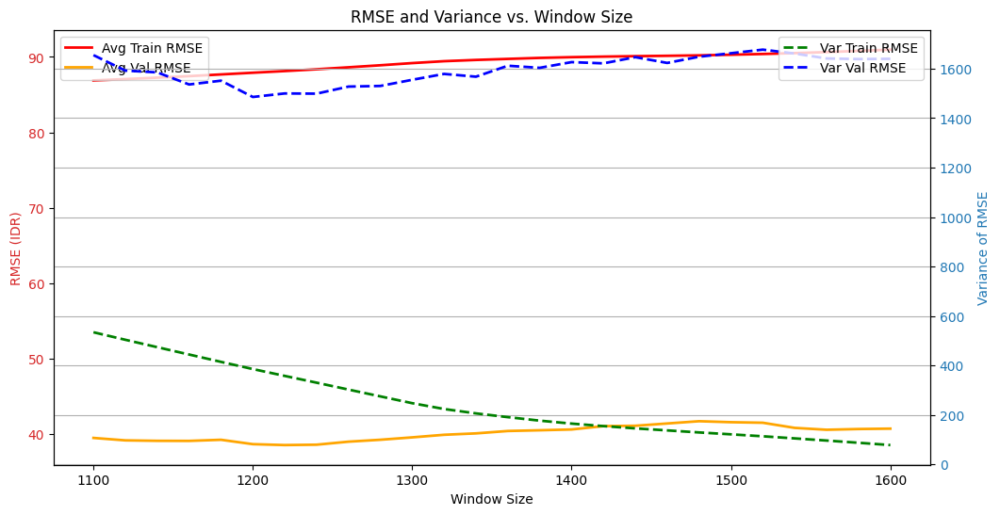

In [57]:
import matplotlib.pyplot as plt

# Ensure you have results_summary populated before running this code
if not results_summary.empty:
    # Plotting RMSE and Variance
    fig, ax1 = plt.subplots(figsize=(12, 6))

    # RMSE Plot
    color = 'tab:red'
    ax1.set_xlabel('Window Size')
    ax1.set_ylabel('RMSE (IDR)', color=color)

    # Plot average RMSE as lines without points
    ax1.plot(results_summary['window_size'].values, results_summary['avg_train_rmse'].values, 
              label='Avg Train RMSE', color='red', linewidth=2)
    ax1.plot(results_summary['window_size'].values, results_summary['avg_val_rmse'].values, 
              label='Avg Val RMSE', color='orange', linewidth=2)

    ax1.tick_params(axis='y', labelcolor=color)
    ax1.legend(loc='upper left')

    # Create a second y-axis for variance
    ax2 = ax1.twinx()
    color = 'tab:blue'
    ax2.set_ylabel('Variance of RMSE', color=color)  # Set the label for the second Y axis

    # Plot variance of RMSE as lines without points
    ax2.plot(results_summary['window_size'].values, results_summary['var_train_rmse'].values, 
             label='Var Train RMSE', color='green', linestyle='--', linewidth=2)
    ax2.plot(results_summary['window_size'].values, results_summary['var_val_rmse'].values, 
             label='Var Val RMSE', color='blue', linestyle='--', linewidth=2)

    ax2.tick_params(axis='y', labelcolor=color)
    ax2.legend(loc='upper right')

    plt.title('RMSE and Variance vs. Window Size')
    plt.grid()
    plt.show()
else:
    print("Results summary is empty.")

In [62]:
from sklearn.linear_model import LinearRegression
import numpy as np
import pandas as pd

# Separate df into features and target
features_df = df_features.drop(['date', 'next_hourly_close_last'], axis=1)
target_df = df_features['next_hourly_close_last']
date_df = df_features['date']

# Convert to NumPy arrays
X = features_df.values
y = target_df.values

# Specify parameters for the sliding window approach
window_size = 1220  # Optimal window size based on parameter tuning
num_display = 20    # Number of recent predictions to display

# Lists to store validation and training RMSEs (excluding the last window from avg calculations)
all_val_rmse = []
all_val_rmse_perc = []
all_train_rmse = []
all_train_rmse_perc = []

# Store predictions only for the latest date on the data
last_predictions = []

# Number of windows to process
num_windows = len(X) - window_size - 1  # Exclude last row for training

# Loop through each sliding window
window_number = 0
while window_number <= num_windows:
    start = window_number
    end = start + window_size
    X_train = X[start:end]
    y_train = y[start:end]

    X_train_mean = np.mean(X_train, axis=0)
    X_train_std = np.std(X_train, axis=0)
    X_train_normalized = (X_train - X_train_mean) / X_train_std

    # Get the column index for 'next_close' from features_df
    close_index = features_df.columns.get_loc('hourly_close_last')

    # Normalize y_train using the mean and std of weekly_volatility
    close_mean = X_train[:, close_index].mean()
    close_std = X_train[:, close_index].std()
    y_train_normalized = (y_train - close_mean) / close_std
    
    # Prepare validation data for prediction
    if end < len(X) - 1:  # Ensure there's data for validation
        X_val = X[end:end + 1]  # Validation is the next row after the current window
        y_val = y[end:end + 1]  # The target for validation
        val_date = date_df.iloc[end:end + 1].values  # Get the date for validation

        # Normalize validation data using the statistics from the training set
        X_val_normalized = (X_val - X_train_mean) / X_train_std

        # Skip this iteration if y_train contains NaN
        if np.isnan(y_train).any() or np.isnan(y_val).any():
            window_number += 1
            continue

        # Initialize and fit the model
        model = LinearRegression()
        model.fit(X_train_normalized, y_train_normalized)

        # Predict on validation data
        y_pred_val = model.predict(X_val_normalized)

        # Denormalize y_val, y_pred_train, and y_pred_val using the mean and std of weekly_volatility
        y_pred_val_denorm = y_pred_val * close_std + close_mean

        # Check if we're in the last 3 windows to display
        if end >= len(X) - num_display:
            # Use the date for the next row as the prediction date
            if end + 1 < len(X):  # Ensure there's a valid next row
                next_row_date = date_df.iloc[end + 1]
                last_predictions.append((next_row_date, y_val[0], y_pred_val_denorm[0]))

    # Move to the next window
    window_number += 1

# Use the features of the last row for prediction
if len(X) > 0:
    last_row_features = X[-1].reshape(1, -1)  # Reshape to 2D for prediction
    last_row_pred = model.predict(last_row_features)
    last_row_date = date_df.iloc[-1]

    # Append the last row prediction with the correct date
    last_predictions.append((last_row_date + pd.Timedelta(hours=1), np.nan, last_row_pred[0]))

# Print the most recent predictions and actual values for the last three days
print("\nRecent Predictions and Actual Values:")
for i, (date, actual, pred) in enumerate(reversed(last_predictions)):
    if np.isnan(actual):
        print(f"Date: {date}, Prediction: {pred:.3f}")
    else:
        error = abs(actual - pred)  # Calculate the absolute error
        error_perc = ((pred/actual)-1)*100
        print(f"Date: {date}, Prediction: {pred:.3f}, Actual: {actual:.3f},  Error: {error:.3f}, Error %: {error_perc:.3f}%")


Recent Predictions and Actual Values:
Date: 2024-12-06, Prediction: 15762.924
Date: 2024-12-06, Prediction: 15912.094, Actual: 15957.000,  Error: 44.906, Error %: -0.281%
Date: 2024-12-05, Prediction: 16023.673, Actual: 15917.000,  Error: 106.673, Error %: 0.670%
Date: 2024-12-04, Prediction: 15925.162, Actual: 16034.000,  Error: 108.838, Error %: -0.679%
Date: 2024-12-03, Prediction: 15887.720, Actual: 15928.000,  Error: 40.280, Error %: -0.253%
Date: 2024-12-02, Prediction: 15871.864, Actual: 15900.000,  Error: 28.136, Error %: -0.177%
Date: 2024-12-01, Prediction: 15859.354, Actual: 15871.000,  Error: 11.646, Error %: -0.073%
Date: 2024-11-30, Prediction: 15840.941, Actual: 15854.000,  Error: 13.059, Error %: -0.082%
Date: 2024-11-29, Prediction: 15899.439, Actual: 15859.000,  Error: 40.439, Error %: 0.255%
Date: 2024-11-28, Prediction: 15984.822, Actual: 15900.000,  Error: 84.822, Error %: 0.533%
Date: 2024-11-27, Prediction: 15999.546, Actual: 15986.000,  Error: 13.546, Error %: 